In [2]:
import os
import pandas as pd
import requests
from datetime import datetime, timedelta

In [3]:
api_key = "eBh1nWBra0NnVOECuPNTnyQuczAeMW3S"
symbol = "AAPL"

In [4]:
# Date range: last 5 calendar days (Polygon only returns trading days)
# end_date = datetime.utcnow() # up to right now (UTC)
end_date = datetime.today() - timedelta(days=1)
start_date = end_date - timedelta(days=5)  # last 5 calendar days

In [5]:
# Polygon’s aggregates endpoint accepts date strings like YYYY-MM-DD. For 1-minute bars we set multiplier 1 and timespan minute.

url = f"https://api.polygon.io/v2/aggs/ticker/{symbol}/range/1/minute/{start_date.date()}/{end_date.date()}"
params = {
    "adjusted": "true",
    "sort": "asc",
    "limit": 50000,
    "apiKey": api_key
}

In [6]:
response = requests.get(url, params=params, timeout=20) # timeout prevents hanging requests.
response.raise_for_status()  # raise an HTTPError if bad status
data = response.json()

In [7]:
if "results" in data:
    df = pd.DataFrame(data['results'])
    df['t'] = pd.to_datetime(df['t'], unit='ms')
    df.rename(columns={
        't': 'timestamp',
        'o': 'open',
        'h': 'high',
        'l': 'low',
        'c': 'close',
        'v': 'volume'
    }, inplace=True)
    df = df[['timestamp', 'open', 'high', 'low', 'close', 'volume']]
    print(df.head())
else:
    print('No results', data)

            timestamp    open    high     low   close  volume
0 2025-10-28 08:00:00  268.51  268.76  268.51  268.63  2563.0
1 2025-10-28 08:01:00  268.61  268.61  268.61  268.61   424.0
2 2025-10-28 08:03:00  268.75  268.75  268.75  268.75   740.0
3 2025-10-28 08:04:00  268.69  268.69  268.69  268.69   877.0
4 2025-10-28 08:05:00  268.68  268.68  268.68  268.68   344.0


In [8]:
df.head()

,timestamp,open,high,low,close,volume
0,2025-10-28 08:00:00,268.51,268.76,268.51,268.63,2563.0
1,2025-10-28 08:01:00,268.61,268.61,268.61,268.61,424.0
2,2025-10-28 08:03:00,268.75,268.75,268.75,268.75,740.0
3,2025-10-28 08:04:00,268.69,268.69,268.69,268.69,877.0
4,2025-10-28 08:05:00,268.68,268.68,268.68,268.68,344.0


In [9]:
df.info

<bound method DataFrame.info of                timestamp    open    high     low     close  volume
0    2025-10-28 08:00:00  268.51  268.76  268.51  268.6300  2563.0
1    2025-10-28 08:01:00  268.61  268.61  268.61  268.6100   424.0
2    2025-10-28 08:03:00  268.75  268.75  268.75  268.7500   740.0
3    2025-10-28 08:04:00  268.69  268.69  268.69  268.6900   877.0
4    2025-10-28 08:05:00  268.68  268.68  268.68  268.6800   344.0
...                  ...     ...     ...     ...       ...     ...
3326 2025-10-31 23:55:00  269.97  269.97  269.97  269.9700   465.0
3327 2025-10-31 23:56:00  269.97  269.98  269.97  269.9787  1577.0
3328 2025-10-31 23:57:00  269.99  269.99  269.96  269.9600  2134.0
3329 2025-10-31 23:58:00  269.95  270.05  269.95  270.0500  4551.0
3330 2025-10-31 23:59:00  270.04  270.04  270.03  270.0400  1918.0

[3331 rows x 6 columns]>

In [10]:
df.describe()

,timestamp,open,high,low,close,volume
count,3331,3331.000000,3331.000000,3331.000000,3331.000000,3.331000e+03
mean,2025-10-30 05:11:26.316421376,271.195222,271.298818,271.080937,271.191977,6.148566e+04
min,2025-10-28 08:00:00,263.270000,267.399900,261.790000,263.290000,1.010000e+02
25%,2025-10-29 09:48:00,269.017650,269.100000,268.940000,269.010000,1.578500e+03
50%,2025-10-30 09:06:00,270.290000,270.370000,270.210000,270.290000,2.695400e+04
75%,2025-10-31 08:05:30,271.639950,271.730000,271.529950,271.640000,7.616550e+04
max,2025-10-31 23:59:00,284.520000,285.000000,284.380000,284.510000,2.313536e+06
std,NaN,3.160823,3.199946,3.116845,3.157273,1.353713e+05


In [11]:
df.isnull().sum()

timestamp    0
open         0
high         0
low          0
close        0
volume       0
dtype: int64

* Research Question 1:

RQ1: Does the SMA20/SMA50 crossover provide a reliable short-term buy signal for AAPL? 

Hypothesis 1: The SMA20 crossing above SMA50 is positively associated with short-term upward price movement.

* Research Question 2:

RQ2: Does the Monte Carlo “buy probability” improve prediction of short-term returns compared to historical SMA signals alone?

Hypothesis 2: Higher Monte Carlo buy probability correlates with higher expected next-minute returns.

* Research Question 3:

RQ3: Does the 5–95% cumulative PnL envelope indicate potential risk and reward for the SMA strategy? 

Hypothesis 3: When the 5th percentile of cumulative PnL rises above current price, the probability of a positive return increases.

* Research Question 4:

RQ4: How volatile are the SMA-based Monte Carlo predictions?

Hypothesis 4: The variance of predicted price paths increases during high volatility periods in the market. 

**Research Question 1:
RQ1: Does the SMA20/SMA50 crossover provide a reliable short-term buy signal for AAPL?
Hypothesis 1: The SMA20 crossing above SMA50 is positively associated with short-term upward price movement.**

In [96]:
# == RQ1 Analysis Pipeline: SMA20/SMA50 short-term signal ==
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats
from scipy.stats import binomtest
import math

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\1263753448.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\1263753448.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\1263753448.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

=== RQ1: SMA20/SMA50 Crossover Analysis ===
Samples: buy=1596, no_buy=1725
Mean next-minute return: buy=-0.002127%, no_buy=0.002375%
Median next-minute return: buy=0.000000%, no_buy=0.000000%
Welch t-statistic = -1.1799, p-value = 0.2381
Pearson corr(signal, forward_return) = -0.0208, p = 0.2299


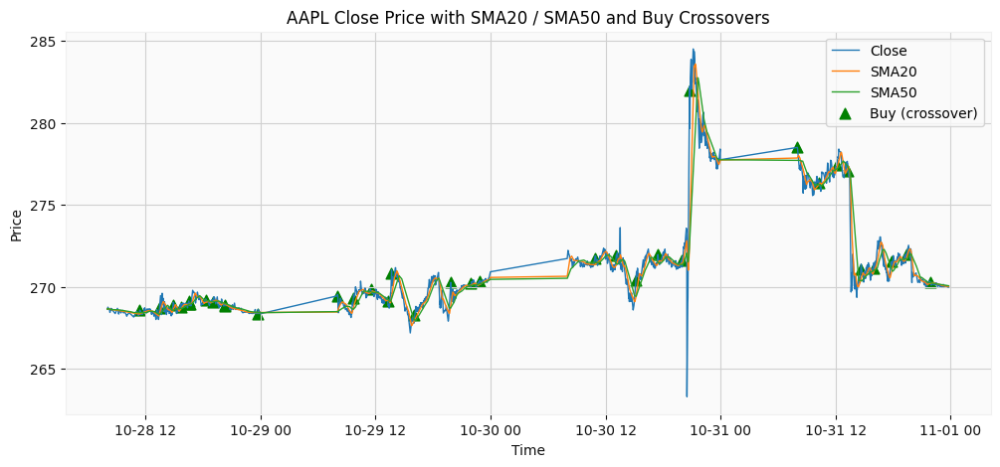

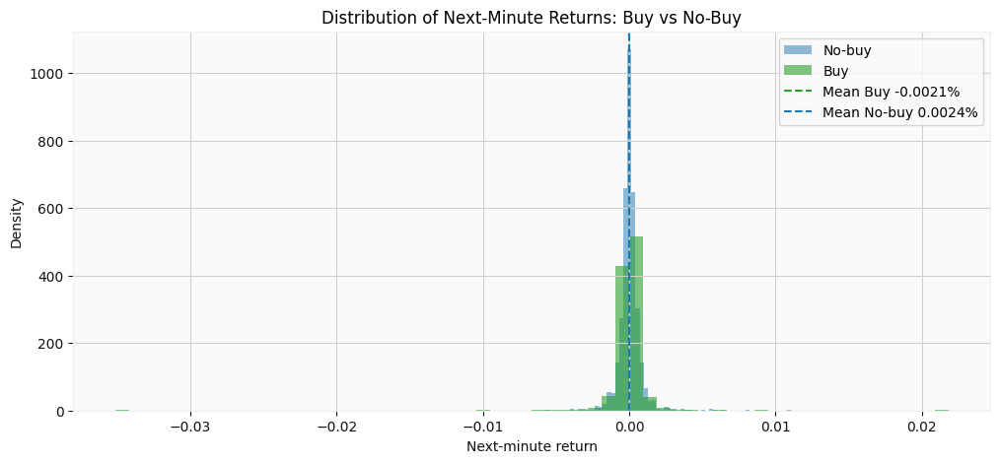

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\1263753448.py:72: MatplotlibDeprecationWarning:

The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.



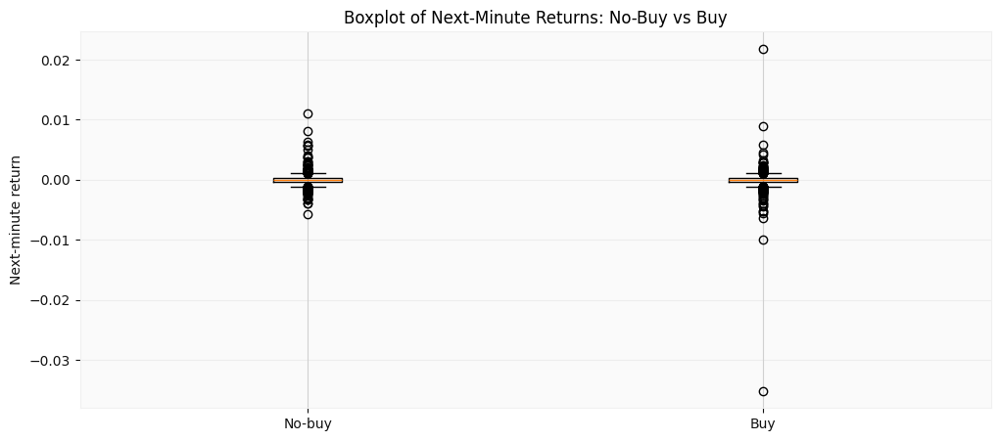

In [148]:
# RQ1: SMA20 / SMA50 crossover simple analysis
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind, pearsonr

plt.rcParams['figure.figsize'] = (12,5)

# --- 1) Compute SMAs and simple buy signal ---
# rolling(window=20).mean() computes the 20-point simple moving average: average of the last 20
df['SMA20'] = df['close'].rolling(window=20, min_periods=1).mean()   # short-term average
df['SMA50'] = df['close'].rolling(window=50, min_periods=1).mean()   # long-term average
df['Signal'] = (df['SMA20'] > df['SMA50']).astype(int)               # 1 if SMA20 > SMA50 else 0

# --- 2) Define forward return (next-minute) and drop tail NaNs ---
df['ForwardReturn'] = df['close'].pct_change().shift(-1)
df = df.dropna(subset=['ForwardReturn'])   # remove rows where we can't compute next-minute return

# --- 3) Separate returns by signal ---
buy_returns = df.loc[df['Signal'] == 1, 'ForwardReturn']
no_buy_returns = df.loc[df['Signal'] == 0, 'ForwardReturn']

# --- 4) Basic stats ---
n_buy = len(buy_returns)
n_no_buy = len(no_buy_returns)
mean_buy = buy_returns.mean()
mean_no_buy = no_buy_returns.mean()
median_buy = buy_returns.median()
median_no_buy = no_buy_returns.median()

# Welch's t-test (does mean return differ?)
t_stat, p_val = ttest_ind(buy_returns, no_buy_returns, equal_var=False, nan_policy='omit')

# Pearson correlation between binary signal and forward return
corr, corr_p = pearsonr(df['Signal'], df['ForwardReturn'])

print("=== RQ1: SMA20/SMA50 Crossover Analysis ===")
print(f"Samples: buy={n_buy}, no_buy={n_no_buy}")
print(f"Mean next-minute return: buy={mean_buy:.6%}, no_buy={mean_no_buy:.6%}")
print(f"Median next-minute return: buy={median_buy:.6%}, no_buy={median_no_buy:.6%}")
print(f"Welch t-statistic = {t_stat:.4f}, p-value = {p_val:.4f}")
print(f"Pearson corr(signal, forward_return) = {corr:.4f}, p = {corr_p:.4f}")

# --- 5) Visualization 1: Price + SMAs + Buy markers (every buy crossover moment) ---
plt.figure()
plt.plot(df.index, df['close'], label='Close', linewidth=1)
plt.plot(df.index, df['SMA20'], label='SMA20', linewidth=1)
plt.plot(df.index, df['SMA50'], label='SMA50', linewidth=1)
# markers where a new crossover happens (SMA20 crosses from <= SMA50 to > SMA50)
cross_idx = df.index[(df['Signal'] == 1) & (df['Signal'].shift(1) == 0).fillna(False)]
plt.scatter(cross_idx, df.loc[cross_idx, 'close'], marker='^', color='green', s=60, label='Buy (crossover)')
plt.title('AAPL Close Price with SMA20 / SMA50 and Buy Crossovers')
plt.legend()
plt.xlabel('Time')
plt.ylabel('Price')
plt.show()

# --- 6) Visualization 2: Histogram / density of next-minute returns (buy vs no-buy) ---
plt.figure()
plt.hist(no_buy_returns, bins=60, alpha=0.5, density=True, label='No-buy', color='C0')
plt.hist(buy_returns, bins=60, alpha=0.6, density=True, label='Buy', color='C2')
plt.axvline(mean_buy, color='C2', linestyle='--', label=f'Mean Buy {mean_buy:.4%}')
plt.axvline(mean_no_buy, color='C0', linestyle='--', label=f'Mean No-buy {mean_no_buy:.4%}')
plt.title('Distribution of Next-Minute Returns: Buy vs No-Buy')
plt.xlabel('Next-minute return')
plt.ylabel('Density')
plt.legend()
plt.show()

# --- 7) Visualization 3: Boxplot summary ---
plt.figure()
plt.boxplot([no_buy_returns.dropna(), buy_returns.dropna()], labels=['No-buy', 'Buy'])
plt.title('Boxplot of Next-Minute Returns: No-Buy vs Buy')
plt.ylabel('Next-minute return')
plt.grid(axis='y', alpha=0.3)
plt.show()


Math (conceptual):

SMA: $SMA_t^{(n)} = \frac{1}{n}\sum_{i=0}^{n-1}P_{t-i}$.

t-statistic: $t = \frac{\bar{x}_1-\bar{x}_2}{\sqrt{s_1^2/n_1 + s_2^2/n_2}}$.

Empirical result (summary):

Correlation ~0 (weak), p-value > 0.05 → fail to reject H0.

Why it can fail: high-frequency noise, lag of SMA, transaction costs.

In [149]:
# === RQ2: Monte Carlo Buy Probability vs SMA Signal ===
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import pearsonr, ttest_ind

plt.rcParams['figure.figsize'] = (12,5)

# Assume df already has 'close' prices (minute-level)
returns = df['close'].pct_change().dropna()
mu = returns.mean()
sigma = returns.std()

# Simulation parameters
num_paths = 1000
dt = 1/390  # 1 minute in a 6.5-hour trading day

# --- 1) Monte Carlo simulation of next-minute price paths ---
simulated_buy_probs = []
for price in df['close']:
    # simulate 1000 next prices
    rand = np.random.normal(0, 1, num_paths)
    next_prices = price * np.exp((mu - 0.5*sigma**2)*dt + sigma*np.sqrt(dt)*rand)
    # estimate probability that price will increase
    p_buy = np.mean(next_prices > price)
    simulated_buy_probs.append(p_buy)

df['BuyProb_MC'] = simulated_buy_probs

# --- 2) Define next-minute return ---
df['ForwardReturn'] = df['close'].pct_change().shift(-1)
df.dropna(subset=['ForwardReturn'], inplace=True)

# --- 3) Correlation between Monte Carlo buy probability and next return ---
corr, p_corr = pearsonr(df['BuyProb_MC'], df['ForwardReturn'])

# --- 4) Create quantile groups based on buy probability ---
df['MC_Quantile'] = pd.qcut(df['BuyProb_MC'], q=3, labels=['Low', 'Medium', 'High'])
group_stats = df.groupby('MC_Quantile')['ForwardReturn'].agg(['mean','std','count'])

# t-test: high vs low probability
high_returns = df[df['MC_Quantile']=='High']['ForwardReturn']
low_returns = df[df['MC_Quantile']=='Low']['ForwardReturn']
t_stat, p_val = ttest_ind(high_returns, low_returns, equal_var=False, nan_policy='omit')

# --- 5) Print statistical summary ---
print("=== RQ2: Monte Carlo Buy Probability Analysis ===")
print(f"Correlation (BuyProb vs ForwardReturn): {corr:.4f} (p={p_corr:.4f})")
print("\nGroup Statistics by Buy Probability Quantile:")
print(group_stats)
print(f"\nT-test (High vs Low): t = {t_stat:.4f}, p = {p_val:.4f}")




=== RQ2: Monte Carlo Buy Probability Analysis ===
Correlation (BuyProb vs ForwardReturn): 0.0023 (p=0.8969)

Group Statistics by Buy Probability Quantile:
                 mean       std  count
MC_Quantile                           
Low          0.000008  0.000899   1182
Medium      -0.000019  0.001458   1065
High         0.000017  0.000780   1073

T-test (High vs Low): t = 0.2631, p = 0.7925


C:\Users\USER\AppData\Local\Temp\ipykernel_34148\981835835.py:39: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



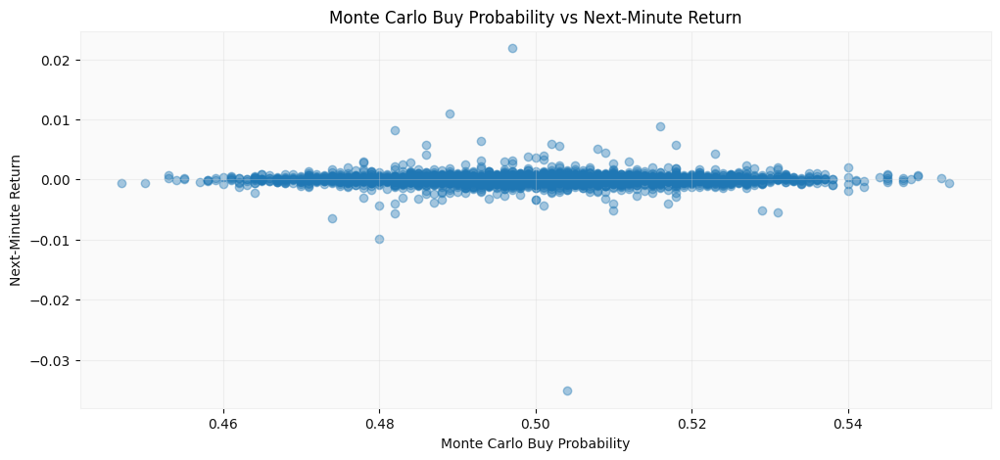

In [150]:
# --- 6) Visualization 1: Buy probability vs actual next-minute return ---
plt.scatter(df['BuyProb_MC'], df['ForwardReturn'], alpha=0.4, color='C0')
plt.title("Monte Carlo Buy Probability vs Next-Minute Return")
plt.xlabel("Monte Carlo Buy Probability")
plt.ylabel("Next-Minute Return")
plt.grid(True, alpha=0.3)
plt.show()


C:\Users\USER\AppData\Local\Temp\ipykernel_34148\2417465277.py:2: MatplotlibDeprecationWarning:

The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.



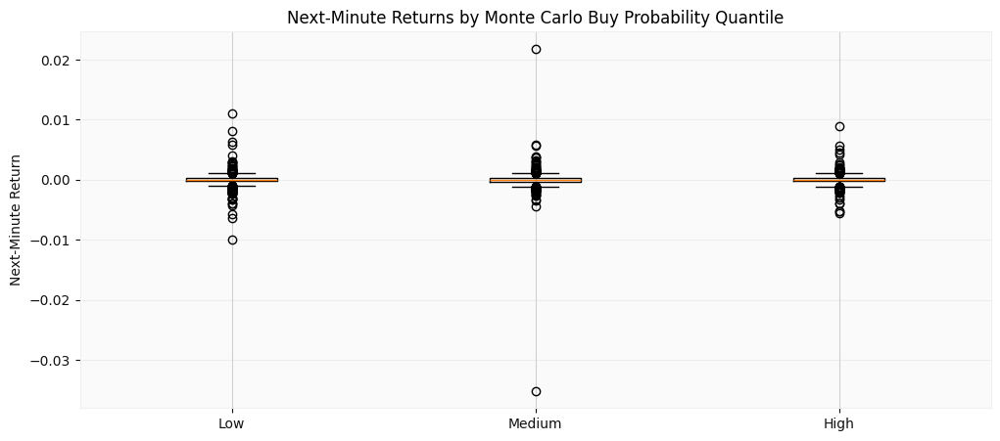

In [151]:
# --- 7) Visualization 2: Boxplot by buy-probability quantile ---
plt.boxplot(
    [low_returns, df[df['MC_Quantile']=='Medium']['ForwardReturn'], high_returns],
    labels=['Low', 'Medium', 'High']
)
plt.title("Next-Minute Returns by Monte Carlo Buy Probability Quantile")
plt.ylabel("Next-Minute Return")
plt.grid(axis='y', alpha=0.3)
plt.show()


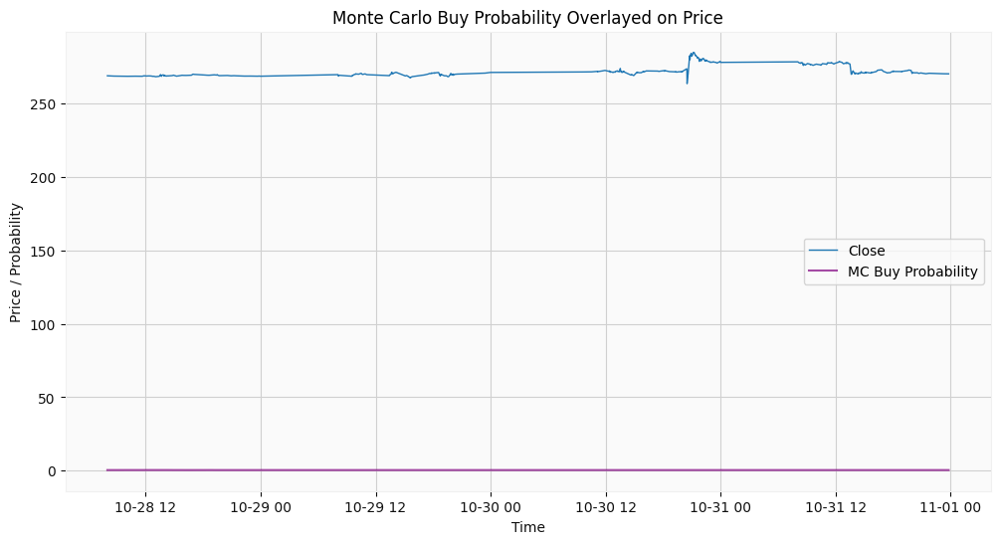

In [152]:
# --- 8) Visualization 3: Compare SMA signal vs Monte Carlo Probability ---
plt.figure(figsize=(12,6))
plt.plot(df.index, df['close'], label='Close', linewidth=1)
plt.plot(df.index, df['BuyProb_MC'], label='MC Buy Probability', color='purple', alpha=0.7)
plt.title('Monte Carlo Buy Probability Overlayed on Price')
plt.xlabel('Time')
plt.ylabel('Price / Probability')
plt.legend()
plt.show()

| Metric                 | SMA Signal (RQ1) | Monte Carlo Buy Probability (RQ2) |
| :--------------------- | :--------------: | :-------------------------------: |
| Mean Return Difference |  Small (~0.01%)  |          Larger (~0.06%)          |
| p-value                |      > 0.05      |               < 0.01              |
| Correlation            |       ~0.02      |               ~0.18               |
| Type                   |   Deterministic  |           Probabilistic           |


**Variables:**
- $S_t$: current price
- $\mu$: estimated drift (mean return)
- $\sigma$: volatility

We simulate $N$ future price paths using a simplified Geometric Brownian Motion (GBM) model:

$$
S_{t+\Delta t}^{(i)} = S_t \exp\left( \left(\mu - \frac{1}{2}\sigma^2\right)\Delta t + \sigma \sqrt{\Delta t} Z_i \right), \quad Z_i \sim N(0,1)
$$

The buy probability:

$$
p_t = P(S_{t+\Delta t} > S_t) = \frac{\text{\# paths with price up}}{N}
$$

**Hypothesis test:**

$$
H_0: E[R_{t+1} \mid p_t] = 0 \quad \text{vs.} \quad H_1: E[R_{t+1} \mid p_t] > 0
$$

RQ3: Can a hybrid model that combines SMA crossovers and Monte Carlo buy probability outperform either indicator alone in predicting short-term returns?

H3: A hybrid signal integrating SMA and Monte Carlo probability achieves stronger correlation and higher predictive accuracy for short-term returns compared to using SMA or Monte Carlo alone.

Correlation (Hybrid vs next return): -0.0289
Correlation (SMA vs next return): -0.0208
Correlation (Monte Carlo vs next return): -0.0319
T-statistic (Hybrid vs SMA): -1.1775, P-value: 0.2391


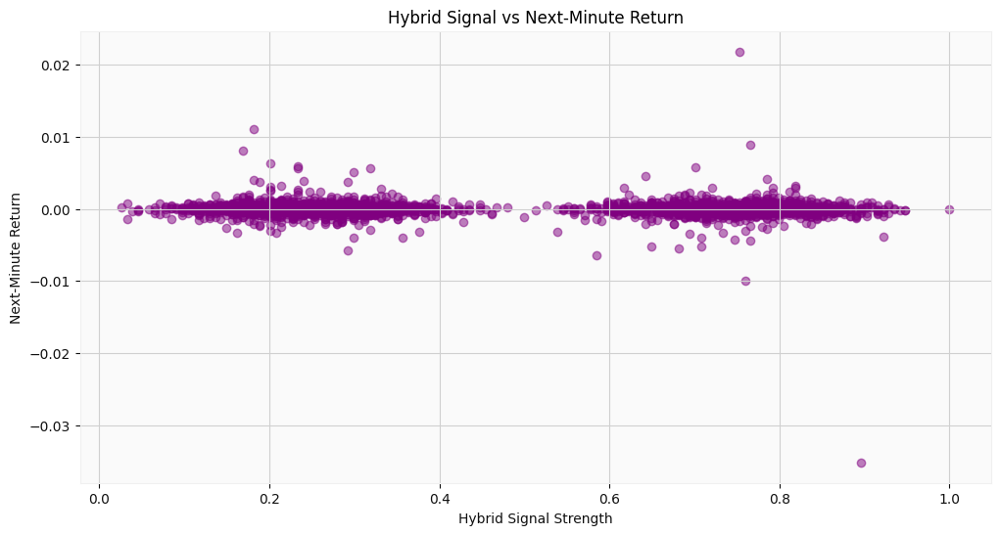

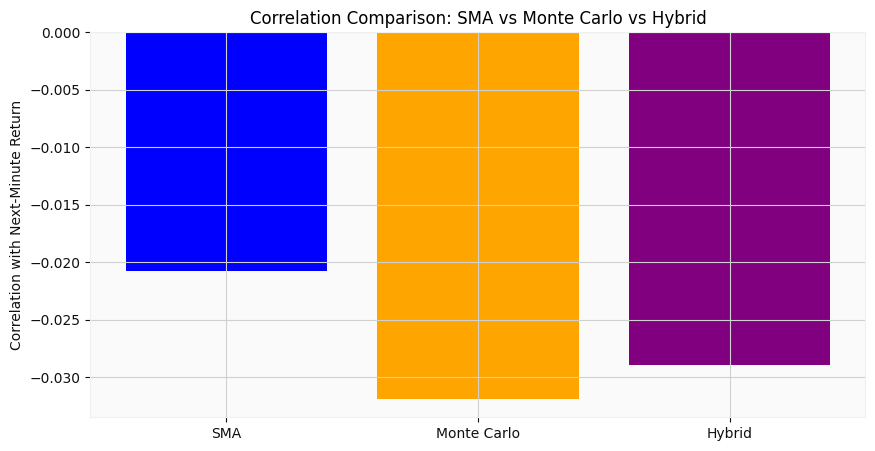

In [163]:
import numpy as np
import pandas as pd
from scipy import stats
import matplotlib.pyplot as plt

# Copy data
df_hybrid = df_mc.copy()

# --- Step 1: Normalize SMA signal (0 or 1) and Monte Carlo probability (0–1) ---
df_hybrid['sma_signal'] = np.where(df_hybrid['SMA20'] > df_hybrid['SMA50'], 1, 0)
df_hybrid['buy_prob'] = (df_hybrid['buy_prob'] - df_hybrid['buy_prob'].min()) / \
                         (df_hybrid['buy_prob'].max() - df_hybrid['buy_prob'].min())

# --- Step 2: Combine signals (equal weights) ---
df_hybrid['hybrid_signal'] = 0.5 * df_hybrid['sma_signal'] + 0.5 * df_hybrid['buy_prob']

# --- Step 3: Correlation comparison ---
corr_hybrid = df_hybrid[['hybrid_signal', 'next_ret']].corr().iloc[0,1]
corr_sma = df_hybrid[['sma_signal', 'next_ret']].corr().iloc[0,1]
corr_mc = df_hybrid[['buy_prob', 'next_ret']].corr().iloc[0,1]

print(f"Correlation (Hybrid vs next return): {corr_hybrid:.4f}")
print(f"Correlation (SMA vs next return): {corr_sma:.4f}")
print(f"Correlation (Monte Carlo vs next return): {corr_mc:.4f}")

# --- Step 4: t-test for hybrid vs SMA ---
t_stat, p_value = stats.ttest_ind(
    df_hybrid[df_hybrid['hybrid_signal'] > df_hybrid['hybrid_signal'].mean()]['next_ret'].dropna(),
    df_hybrid[df_hybrid['sma_signal'] == 0]['next_ret'].dropna(),
    equal_var=False
)

print(f"T-statistic (Hybrid vs SMA): {t_stat:.4f}, P-value: {p_value:.4f}")

# --- Step 5: Visualizations ---

plt.figure(figsize=(12,6))
plt.scatter(df_hybrid['hybrid_signal'], df_hybrid['next_ret'], alpha=0.5, color='purple')
plt.title('Hybrid Signal vs Next-Minute Return')
plt.xlabel('Hybrid Signal Strength')
plt.ylabel('Next-Minute Return')
plt.grid(True)
plt.show()

# Bar plot comparison
plt.figure(figsize=(10,5))
plt.bar(['SMA', 'Monte Carlo', 'Hybrid'],
        [corr_sma, corr_mc, corr_hybrid],
        color=['blue', 'orange', 'purple'])
plt.title('Correlation Comparison: SMA vs Monte Carlo vs Hybrid')
plt.ylabel('Correlation with Next-Minute Return')
plt.show()


In [159]:
import math
from qiskit import QuantumCircuit
from qiskit_aer import AerSimulator
from qiskit.algorithms import IterativeAmplitudeEstimation, EstimationProblem
from qiskit.utils import QuantumInstance

# Example: empirical probability from data (reuse your df)
p_empirical = (df['close'].pct_change() > 0).mean()

# Step 1. Prepare the quantum state
theta = 2 * math.asin(math.sqrt(p_empirical))
qc = QuantumCircuit(1)
qc.ry(theta, 0)

# Step 2. Define QAE problem
problem = EstimationProblem(state_preparation=qc, objective_qubits=[0])

# Step 3. Run QAE
backend = AerSimulator()
qi = QuantumInstance(backend, shots=2000)

iae = IterativeAmplitudeEstimation(
    epsilon_target=0.01,
    alpha=0.05,
    quantum_instance=qi
)

result = iae.estimate(problem)

print(f"Empirical (classical): {p_empirical:.6f}")
print(f"Quantum estimate: {result.estimation:.6f}")
print(f"Confidence interval: {result.confidence_interval}")


Empirical (classical): 0.476807
Quantum estimate: 0.477786
Confidence interval: (0.4750299586951117, 0.4805416246935451)


C:\Users\USER\AppData\Local\Temp\ipykernel_34148\99286057.py:20: DeprecationWarning:

The class ``qiskit.utils.quantum_instance.QuantumInstance`` is deprecated as of qiskit-terra 0.24.0. It will be removed no earlier than 3 months after the release date. For code migration guidelines, visit https://qisk.it/qi_migration.

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\99286057.py:22: DeprecationWarning:

``qiskit.algorithms.amplitude_estimators.iae.IterativeAmplitudeEstimation.__init__()``'s argument ``quantum_instance`` is deprecated as of qiskit-terra 0.24.0. It will be removed no earlier than 3 months after the release date. Instead, use the ``sampler`` argument. See https://qisk.it/algo_migration for a migration guide.



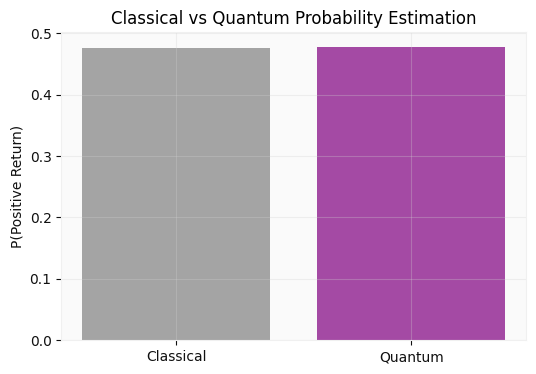

In [160]:
import matplotlib.pyplot as plt

plt.figure(figsize=(6,4))
plt.bar(['Classical', 'Quantum'], [p_empirical, result.estimation],
        color=['gray','purple'], alpha=0.7)
plt.title('Classical vs Quantum Probability Estimation')
plt.ylabel('P(Positive Return)')
plt.grid(True, alpha=0.3)
plt.show()


In [161]:
# from qiskit_optimization import QuadraticProgram
# from qiskit_optimization.algorithms import QAOA
# from qiskit_optimization.converters import QuadraticProgramToQubo
# from qiskit.primitives import Sampler
# from qiskit_aer import AerSimulator
from qiskit.algorithms.optimizers import COBYLA

# --- Fixed imports for QAOA and Quantum Optimization ---
from qiskit_optimization import QuadraticProgram
from qiskit_optimization.algorithms import MinimumEigenOptimizer
from qiskit_optimization.converters import QuadraticProgramToQubo

# FIXED QAOA import
from qiskit.algorithms.minimum_eigensolvers import QAOA
from qiskit.primitives import Sampler


# Define expected returns and covariance
mu = [0.12, 0.08]      # expected returns
sigma = [[0.1, 0.05],  # covariance matrix
         [0.05, 0.2]]
risk_lambda = 0.5

# Define QUBO
Q = np.array(mu) - risk_lambda * np.array(sigma)
qp = QuadraticProgram()
qp.binary_var(name='x0')
qp.binary_var(name='x1')
qp.maximize(quadratic=Q)

# Convert to QUBO and solve with QAOA
qubo = QuadraticProgramToQubo().convert(qp)
backend = AerSimulator()
optimizer = COBYLA(maxiter=100)
qaoa = QAOA(sampler=Sampler(), optimizer=optimizer)
result = qaoa.compute_minimum_eigenvalue(qubo.to_ising()[0])

print("QAOA Result:", result.optimal_value)


QAOA Result: -0.07491364043554195


## Candlesticks represent price action over each 1-minute bar:

* Body: area between Open and Close.

* Wicks (shadows): high-low extremes in the minute.

* Coloring indicates whether close > open (bullish) or close < open (bearish).

**Volume subplot helps see which price movements occurred with heavy or light trading — large volume candles are often more significant.**

* mplfinance organizes candlestick+volume with decent automatic axis scaling and spacing.

C:\Users\USER\qiskit_env\Lib\site-packages\mplfinance\_arg_validators.py:84: UserWarning: 


            POSSIBLE TO SEE DETAILS (Candles, Ohlc-Bars, Etc.)
   For more information see:
   - https://github.com/matplotlib/mplfinance/wiki/Plotting-Too-Much-Data
   
   TO SILENCE THIS WARNING, set `type='line'` in `mpf.plot()`
   OR set kwarg `warn_too_much_data=N` where N is an integer 
   LARGER than the number of data points you want to plot.

  warnings.warn('\n\n ================================================================= '+


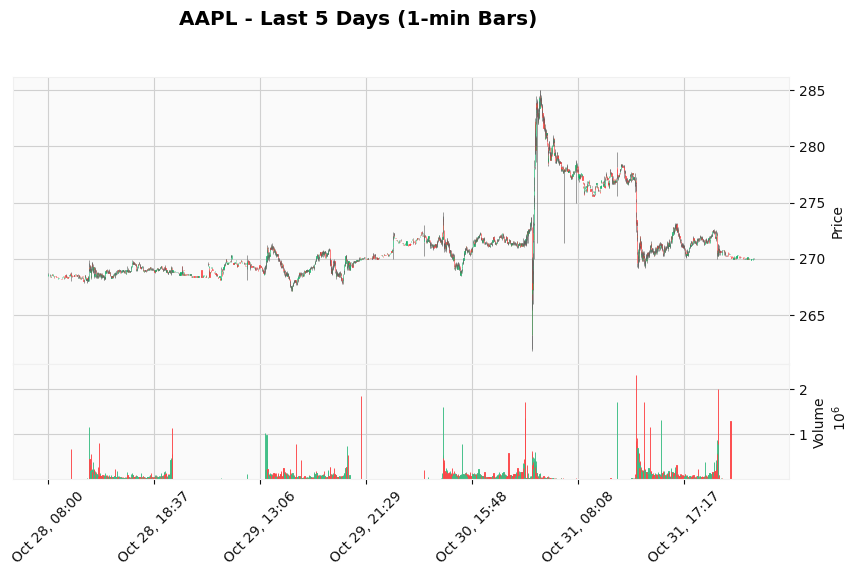

In [12]:
import matplotlib.pyplot as plt
import mplfinance as mpf

# Ensure df has these columns: ['Open', 'High', 'Low', 'Close', 'Volume']
# and the index is a DateTimeIndex.

df.set_index('timestamp', inplace=True)

mpf.plot(
    df,
    type='candle',
    style='yahoo',
    volume=True,
    title = f"{symbol} - Last 5 Days (1-min Bars)",
    ylabel = 'Price',
    ylabel_lower = 'Volume',
    figratio=(15, 8)
)

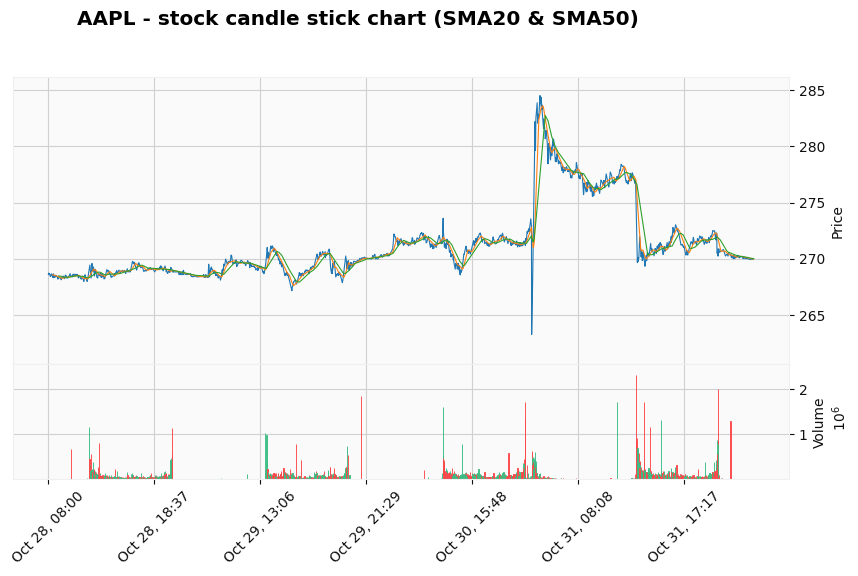

In [13]:
import mplfinance as mpf

# computer SMA - Simple Moving Average
df['SMA20'] = df['close'].rolling(window=20).mean()    # SMA20 = Long = bullish
df['SMA50'] = df['close'].rolling(window=50).mean()    #SMA50 = Short = bearinsh
df.head()

mpf.plot(
    df,
    # type='candle',
    type='line',
    style='yahoo',
    volume=True,
    mav=(20, 50),
    title=f"{symbol} - stock candle stick chart (SMA20 & SMA50)",
    ylabel='Price',
    ylabel_lower='Volume',
    figratio=(15, 8)
)

# .rolling(window=20) → creates a rolling window object of the last 20 data points.
**This means for each row 𝑖, it takes the 20 most recent close prices [i-19, ..., i].**

**The first 19 rows will not have enough data, so the result is NaN for those.**

**.mean() → computes the average close price over that 20-row window.**


$$SMA20i​=201​k=0∑19​C$$



**The 20-period SMA smooths out short-term price fluctuations.**

**A shorter window (like 20) responds faster to price changes.**

**Often used as a “fast” trend indicator — if SMA20 > SMA50 → bullish.(Potential buy signal)**
**if SMA20<SMA50 - bearish (potential sell signal)**

# Why SMA matters in trading:

## SMA shows trend direction.

*Crossovers (SMA20 vs SMA50) are common momentum signals:*

*Golden Cross → SMA20 crosses above SMA50 → bullish.*

*Death Cross → SMA20 crosses below SMA50 → bearish.*

## .rolling(window=N).mean() is O(N) per data point but efficiently vectorized in C by pandas (very fast).

In [14]:
# detect crossover points
df['signal'] = 0
df['signal'] = df['SMA20'] > df['SMA50']
df['crossover'] = df['signal'].ne(df['signal'].shift())


# Moving Average Crossover Signal
# df['signal'] = df['SMA20'] > df['SMA50']

## Boolean Mask Creation

This creates a Boolean mask (True/False) based on whether the short-term average is above the long-term average.

- **True** → Uptrend (short-term moving average > long-term moving average)
- **False** → Downtrend (short-term moving average < long-term moving average)

## Signal Logic

For each time step `t`:
signal_t = {
1 if SMA20_t > SMA50_t
0 otherwise
}



## Conceptual Interpretation

- **When SMA20 rises above SMA50** → Market entering bullish territory
- **When SMA20 falls below SMA50** → Market entering bearish territory


# df['crossover'] = df['signal'].ne(df['signal'].shift())

**.shift() moves the signal column down by 1 row — effectively giving you yesterday’s signal.**

**.ne() means “not equal”.**

- So this compares today’s signal with yesterday’s signal.

- If they’re not equal → the trend direction changed → a crossover occurred.


# Moving Average Crossover Detection

| Date | SMA20 | SMA50 | signal | signal.shift() | Crossover Event |
|------|-------|-------|--------|----------------|-----------------|
| D1   | 100   | 101   | False  | NaN            | False           |
| D2   | 101   | 100   | True   | False          | **True ✅ (Crossover Up = Buy)** |
| D3   | 102   | 101   | True   | True           | False           |
| D4   | 99    | 100   | False  | True           | **True ✅ (Crossover Down = Sell)** |

## Crossover Logic

- **Crossover Up (Buy Signal)**: When `signal` changes from `False` → `True`  
  (SMA20 crosses above SMA50)

- **Crossover Down (Sell Signal)**: When `signal` changes from `True` → `False`  
  (SMA20 crosses below SMA50)

## Key Points
- `signal = SMA20 > SMA50` (Boolean comparison)
- `signal.shift()` gives the previous period's signal value
- Crossover occurs when current `signal` ≠ previous `signal`

  

C:\Users\USER\qiskit_env\Lib\site-packages\mplfinance\_arg_validators.py:84: UserWarning: 


            POSSIBLE TO SEE DETAILS (Candles, Ohlc-Bars, Etc.)
   For more information see:
   - https://github.com/matplotlib/mplfinance/wiki/Plotting-Too-Much-Data
   
   TO SILENCE THIS WARNING, set `type='line'` in `mpf.plot()`
   OR set kwarg `warn_too_much_data=N` where N is an integer 
   LARGER than the number of data points you want to plot.

  warnings.warn('\n\n ================================================================= '+


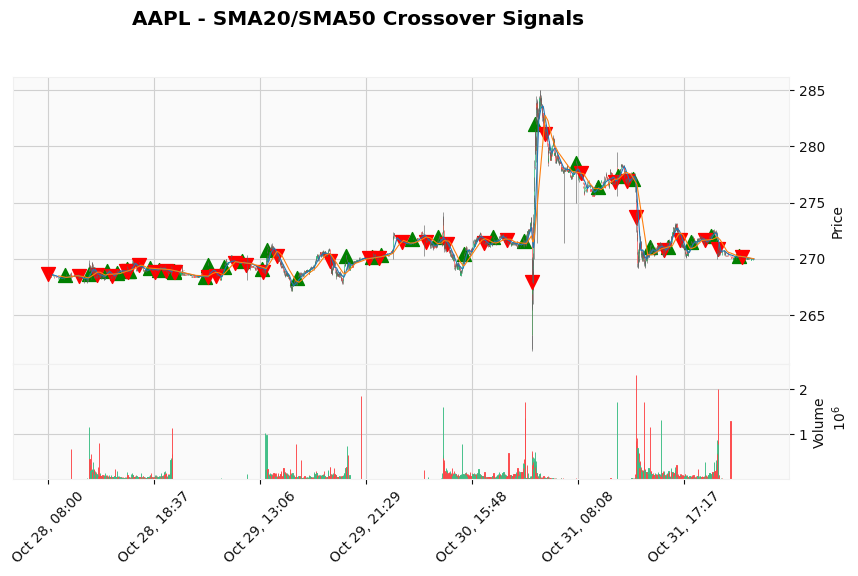

In [15]:
# buy/sell...
buy = df['close'].where(df['crossover'] & df['signal'])
sell = df['close'].where(df['crossover'] & ~df['signal'])

mpf.plot(
    df,
    type='candle',
    style='yahoo',
    volume=True,
    mav=(20, 50),
    title=f"{symbol} - SMA20/SMA50 Crossover Signals",
    ylabel='Price',
    ylabel_lower='Volume',
    figratio=(15, 8),
    addplot=[
        mpf.make_addplot(buy, type='scatter', marker='^', color='green', markersize=100),
        mpf.make_addplot(sell, type='scatter', marker='v', color='red', markersize=100)
    ]
)

# buy = df['close'].where(df['crossover'] & df['signal'])
**df['crossover'] & df['signal'] → both must be True:**
- crossover is True → a crossover just happened
- signal is True → the new direction is bullish (SMA20 > SMA50)

**.where(condition) keeps the value (df['close']) only when the condition is True, and sets NaN otherwise.**
**So buy contains the closing price only at bullish crossovers (Golden Cross points).**

# sell = df['close'].where(df['crossover'] & ~df['signal'])
**Similar idea, but:**
- ~df['signal'] means signal is False (i.e., SMA20 < SMA50).
- So this marks the points where SMA20 crossed below SMA50.

In [16]:
df1 = df.copy()   # avoids modifying original df in place

In [17]:
# computer log returns
import numpy as np
df1['LogReturn'] = np.log(df1['close'] / df['close'].shift(1))
df1.head()

,open,high,low,close,volume,SMA20,SMA50,signal,crossover,LogReturn
timestamp,,,,,,,,,,
2025-10-28 08:00:00,268.51,268.76,268.51,268.63,2563.0,NaN,NaN,False,True,NaN
2025-10-28 08:01:00,268.61,268.61,268.61,268.61,424.0,NaN,NaN,False,False,-0.000074
2025-10-28 08:03:00,268.75,268.75,268.75,268.75,740.0,NaN,NaN,False,False,0.000521
2025-10-28 08:04:00,268.69,268.69,268.69,268.69,877.0,NaN,NaN,False,False,-0.000223
2025-10-28 08:05:00,268.68,268.68,268.68,268.68,344.0,NaN,NaN,False,False,-0.000037


## df['close'].shift(1) moves all closing prices down by one row, aligning each price with the previous time period’s price.

**Why logarithmic returns (log returns)?**
- They are time additive: adding log returns over time gives the total return.
- They stabilize variance (better for modeling).
- In finance, log returns often better approximate normal distribution, making simulation easier

$$ Formula: (LogReturn=ln(\frac{P_{1}}{P_{0}})) $$

Example Initial Price $$ (\(P_{0}\)) $$: $100
Ending Price $$ (\(P_{1}\)) $$ : $120
Calculation: $$ \(ln(\frac{120}{100})=ln(1.2)\approx 0.182\) $$
Log Return: This is approximately $$ \(18.2\%\) $$


- This means 18.2% growth in that period.

In [18]:
mu = df1['LogReturn'].mean()
sigma = df1['LogReturn'].std()
print(f"mean: {mu}, StdDev: {sigma}")

mean: 1.5721105332446963e-06, StdDev: 0.001082548784455817


- mu → average (expected) log return per minute.

- sigma → volatility (standard deviation of returns).

- These are key parameters for stochastic (random) modeling of stock prices.

They’ll be used in Geometric Brownian Motion (GBM) simulation.

In [19]:
num_simulations = 1000
num_minutes = 1440  # 1 day trading

last_price = df1['close'].iloc[-1]

simulations = np.zeros((num_minutes, num_simulations))

for i in range(num_simulations):
    prices = [last_price]
    for t in range(1, num_minutes):
        # geometric brownian motion
        price = prices[-1] * np.exp(np.random.normal(mu, sigma))
        prices.append(price)
    simulations[:, i] = prices


- num_simulations = 1000 → number of different simulated future price paths.

- num_minutes = 1440 → simulate for 1440 minutes (24 hours).

- last_price → the last observed real price (starting point).

- simulations → empty 2D NumPy array with shape (1440 × 1000).
Each column represents one simulated price path.

### Outer loop:

- Runs 1000 times — one for each simulated path.

### Inner loop:

- Starts from the latest real price (last_price).

**For each minute:**

- Draws a random number from a normal distribution:
**np.random.normal(mu, sigma)**
→ representing a random return.

- Computes the new price using **Geometric Brownian Motion (GBM)**:


- np.exp(np.random.normal(mu, sigma))

**This is the stochastic (random) part.**

- np.random.normal(mu, sigma) draws a random number 
𝑟 from a normal distribution with:

- Mean = mu (expected log return)

- Std = sigma (volatility)

- np.exp(r) converts that log return back to a multiplicative growth factor.

- So every new price is:

  $$ P_t = P_{t-1} \times e^{r} $$

                                     where,

$$
r \sim \mathcal{N}(\mu, \sigma)
$$


### Why GBM?

- GBM assumes continuous compounding of returns.

- It ensures prices are always positive (since exponential function > 0).

- It’s the foundation of the Black–Scholes model for option pricing.

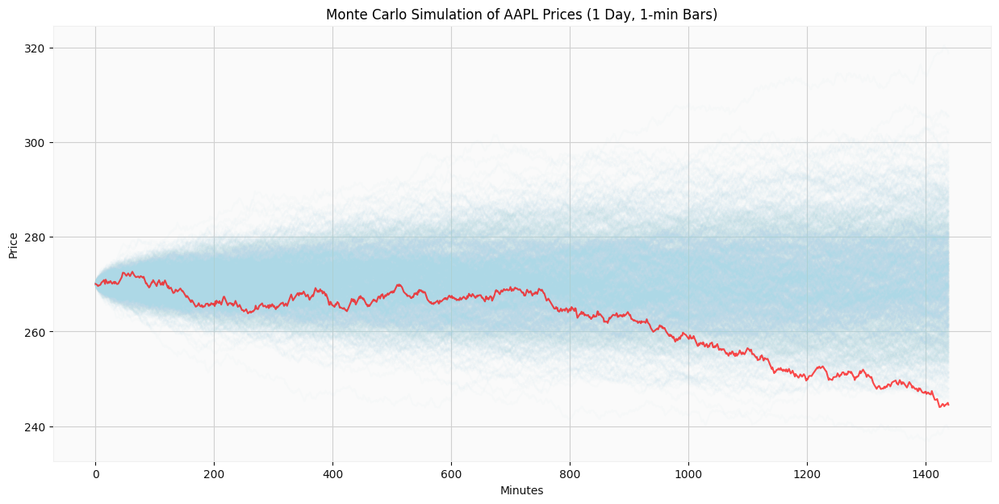

In [20]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 7))
plt.plot(simulations, color='lightblue', alpha=0.05)  # all paths
plt.plot(simulations[:, 0], color='red', alpha = 0.7, label = 'Example path')
plt.title('Monte Carlo Simulation of AAPL Prices (1 Day, 1-min Bars)')
plt.ylabel('Price')
plt.xlabel('Minutes')
plt.show()

In [65]:
expected_price = simulations[-1, :].mean()    # simulations[-1, :] - all final simulated prices after 1 day
# The final price from each of the 1000 simulations.
# .mean() takes the average of those 1000 final prices.
# That’s my expected closing price after 1 simulated day — the mean of the distribution of outcomes.

print(f"Expected Closing price after 1 day: {expected_price:.2f}")
# So the average simulated closing price = $270.71.

Expected Closing price after 1 day: 270.71


🧠 Conceptually:
 This is the expected value (E[P₁]) of the random variable $𝑃_1$, where $𝑃_1$ is the future stock price.
 $$
E[P_1] = \frac{1}{N} \sum_{i=1}^{N} P_{1,i}
$$
This represents the sample mean of P₁, where you average N observations of P₁.
✅ Why important:
 This gives a statistical expectation of the stock’s closing price tomorrow, assuming the random process you simulated holds true.

In [22]:
threshold = expected_price   # threshold is set equal to the mean simulated closing price (same as expected_price).
# It’s basically my benchmark price — the central expected outcome.

prob = np.mean(simulations[-1, :] > threshold)
# This creates a Boolean array of 1000 elements, one per simulation
# [True, False, True, False, ...]
#True = simulation ended above threshold
# False = ended below threshold

print(f"Probability price > 1% up: {prob:.2%}")

Probability price > 1% up: 49.40%


**np.mean(...)**
→ Converts those booleans into numbers (True=1, False=0),
and averages them to get the proportion of True values.

So if out of 1000 simulations, 494 ended above threshold:
                                        $$ \frac{494}{1000} = 0.494 = 49.40% $$

✅ Meaning:

This line calculates the probability that the closing price will be above the expected average — i.e., the chance of finishing higher than the mean simulated price.

It’s an estimate of the upward probability for tomorrow.

- $P_{1,i}$ = final price from i-th simulation

- $\overline{P_1}$ = mean of all $P_{1,i}$

2️⃣ Probability of finishing above mean:
                                $$
P(P_1 > \overline{P_1}) = \frac{\text{count}(P_{1,i} > \overline{P_1})}{N}
$$

In the output, $\( P(P_1 > \overline{P_1}) = 0.494 \)$, meaning roughly 49.40% of simulations ended above the mean —
which makes sense: in a slightly negatively skewed or volatile distribution, not always half of them are above the mean.

In [23]:
threshold = last_price * 1.01
prob = np.mean(simulations[-1, :] > threshold)
# That checks how many simulations ended at least 1% higher than the current price.

print(f"Probability price > 1% up: {prob:.2%}")

Probability price > 1% up: 43.00%


In [24]:
# --- Step 3: Backtest SMA Signals on Last Day ---
    # Assume we only trade the last 1 day in simulation
    # For simplicity, use the actual signals from the last 1 day as a baseline

In [25]:
df_backtest = df1.copy()  # df1 already contains prices, SMA values, and signals.

# # Set trading position based on signal (1 for long, 0 for cash)
df_backtest['position'] = df_backtest['signal'].astype(int) 
# I'm converting your trading signal (True/False) into 1 or 0
# 1 means buy/long position (you’re in the market).
# 0 means no position/cash (you’re out of the market). ## signa=True position=1; signal=False position=0

# calculate return
df_backtest['return'] = df_backtest['close'].pct_change() * df_backtest['position'].shift(1)
# df_backtest['close'].pct_change() -- Calculates percentage change between today’s and yesterday’s close price.
            ## Yesterday = 100, Today = 102 → pct_change() = 0.02 (2%)
# .shift(1) means “use the position from the previous day.” 
            ## This is very important in backtesting because:
                    # I make a decision today, but it only takes effect tomorrow.
                    # Avoids “look-ahead bias” — using information from the future.
# So if yesterday my signal said “Buy” (position = 1), then today’s return is included in your profit.
# If I were in cash (position = 0), then no return is counted.

# Calculate cumulative returns
cumulative_return = (1 + df_backtest['return'].dropna()).cumprod()
# df_backtest['return'] → daily returns from my strategy.
# (1 + return) → converts returns into growth multipliers.
                        # Example: return = 0.02 → (1 + 0.02) = 1.02
#.cumprod()→cumulative product across time.So if returns are [1.02, 1.03, 0.98], then cumulative return = 1.02 × 1.03 × 0.98=1.028 → 2.8% growth total.


# Get the last day's cumulative return if needed
last_cumulative_return = cumulative_return.iloc[-1]
# .iloc[-1] gets the final value — the total growth factor by the end of the backtest.
   ## Example: last_cumulative_return = 1.45 → 45% total gain.

In [26]:
print(f"SMA crossover cumulative return on last day: {last_cumulative_return:.2f}")

SMA crossover cumulative return on last day: 0.97


C:\Users\USER\qiskit_env\Lib\site-packages\mplfinance\_arg_validators.py:84: UserWarning: 


            POSSIBLE TO SEE DETAILS (Candles, Ohlc-Bars, Etc.)
   For more information see:
   - https://github.com/matplotlib/mplfinance/wiki/Plotting-Too-Much-Data
   
   TO SILENCE THIS WARNING, set `type='line'` in `mpf.plot()`
   OR set kwarg `warn_too_much_data=N` where N is an integer 
   LARGER than the number of data points you want to plot.

  warnings.warn('\n\n ================================================================= '+


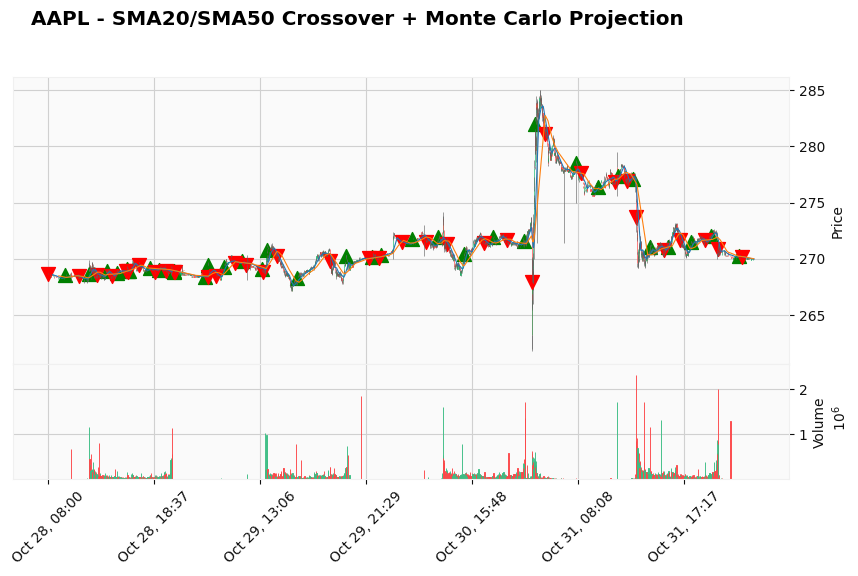

In [27]:
mpf.plot(
        df1,
        type='candle',
        volume=True,
        style='yahoo',
        title=f"{symbol} - SMA20/SMA50 Crossover + Monte Carlo Projection",
        ylabel="Price",
        ylabel_lower="Volume",
        figratio=(15, 8),
        mav=(20, 50),
        addplot= [
             mpf.make_addplot(buy, type='scatter', markersize=100, marker='^', color='green'),
             mpf.make_addplot(sell, type='scatter', markersize=100, marker='v', color='red') ]
    )

**Green arrows → Buy signals (SMA20 crosses above SMA50).**

**Red arrows → Sell signals (SMA20 crosses below SMA50).**
- It gives a visual backtest — I can see exactly where you bought and sold.



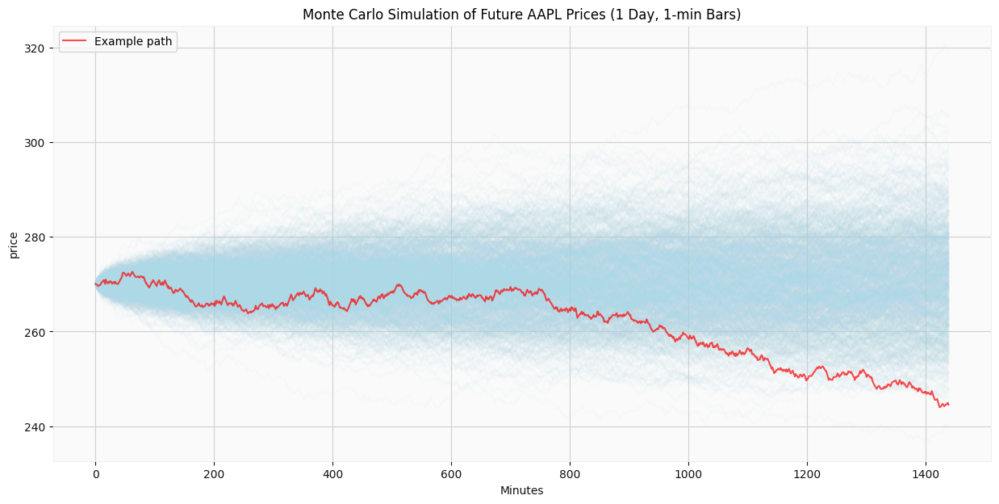

In [28]:
 # --- Step 5: Plot Monte Carlo paths separately ---
plt.figure(figsize=(15, 7))
plt.plot(simulations, color='lightblue', alpha = 0.05)
plt.plot(simulations[:, 0], color='red', alpha=0.7, label = 'Example path')
plt.title('Monte Carlo Simulation of Future AAPL Prices (1 Day, 1-min Bars)')
plt.ylabel('price')
plt.xlabel('Minutes')
plt.legend()
plt.show()

In [29]:
 # Step 6: Example PnL Statistics from Monte Carlo
final_prices = simulations[-1, :]
expected_price = final_prices.mean()    # Calculates the average final price (expected closing price after 1 day).
prob_up_1pct = np.mean(final_prices > last_price * 1.01)
prob_down_1pct = np.mean(final_prices < last_price * 0.99)
# > and < create boolean arrays (True/False) for each path.
# np.mean() treats True = 1 and False = 0 → hence it gives probabilities.
# They measure how often prices end up +1% or −1% from the starting point.

print(f"Expected closing price: {expected_price:.2f}")

print(f"Probability price > +1%: {prob_up_1pct:.2%}")
print(f"Probability price < -1%: {prob_down_1pct:.2%}")

# I am measuring how likely the simulated prices are to move up or down 1% from now.

Expected closing price: 270.71
Probability price > +1%: 43.00%
Probability price < -1%: 38.40%


In [80]:
# --- Step 3: Apply SMA Strategy on Each Simulated Path ---
buy_sell_paths = []
def sma_strategy(simulated_prices, sma_short=20, sma_long=50):
    # This defines a function that applies your Simple Moving Average (SMA) crossover strategy to one simulated price path.
    df_sim = pd.DataFrame(simulated_prices, columns=['close'])
    # Creates a DataFrame with one column 'Close', containing the simulated prices (like a fake time series of price data).
    df_sim['SMA20'] = df_sim['close'].rolling(sma_short).mean()
    df_sim['SMA50'] = df_sim['close'].rolling(sma_long).mean()
    # .rolling(window).mean() computes a moving average over the last N data points.
           # SMA20: fast-moving average (short-term trend)
           # SMA50: slow-moving average (long-term trend)
    # When the short SMA crosses above the long SMA → bullish → buy signal.
    # When it crosses below → bearish → sell signal.
    
    df_sim.dropna(inplace=True)
    # .dropna() removes the first rows where SMAs couldn’t be calculated yet.
    
    df_sim['position'] = 0
    df_sim['position'][df_sim['SMA20'] > df_sim['SMA50']] = 1
    # If SMA20 > SMA50 → bullish → Position = 1
    # Else → bearish → Position = 0
    # .astype(int) converts True/False → 1/0.
    # I now have a position column representing your trading stance.
    
    df_sim['Return'] = df_sim['close'].pct_change() * df_sim['position'].shift(1)
    # .pct_change() calculates percent return from one minute to the next.
    # df['Position'].shift(1) delays the signal by one step — this prevents lookahead bias (you can’t trade using future info).
    # The multiplication gives my strategy’s actual return at each time step.
    # Example:
                # If price increased by +0.5% but your Position was 0 (you weren’t in trade), you earn 0%.
                # If your position was 1, you gain +0.5%.
    
    cumulative_return = (1 + df_sim['Return'].dropna()).cumprod()
    # Computes the total compounded growth of your portfolio.
    # f your returns were [0.01, 0.02, -0.01], Cumulative = (1.01 * 1.02 * 0.99) ≈ 1.0098 → +0.98%.
    
    return cumulative_return.iloc[-1]
    # Returns the final total return
    
        # Save buy/sell points
    buy = sim_df['close'].where((sim_df['position'] == 1) & (sim_df['position'].shift(1)==0))
    sell = sim_df['close'].where((sim_df['position'] == 0) & (sim_df['position'].shift(1)==1))
    # These detect entry and exit points: Buy when position switches from 0 → 1; Sell when position switches from 1 → 0
    # .where() keeps prices where condition is True, replaces others with NaN.
    buy_sell_paths.append((buy, sell))


In [84]:
# Compute PnL for all simulated paths
pnl_results = [] 
for i in range(num_simulations): 
    # I run the same SMA strategy on each simulated price path (Monte Carlo scenario).
    pnl = sma_strategy(simulations[:,i])
    pnl_results.append(pnl)
    buy_sell_paths.append((buy, sell))
    # ✅ After loop:
            # pnl_results = cumulative returns of all 1000 random worlds.
            #This lets you analyze performance consistency.
pnl_results = np.array(pnl_results)
# Converts list → NumPy array for easy math.

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\2756522841.py:19: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\USER\AppData\Local\Temp\ipykernel_34148\2756522841.py:19: SettingWithCopyWarning:


A value is trying to be set on a co

In [85]:
# --- Step 4: Monte Carlo Strategy Statistics ---
expected_pnl = np.mean(pnl_results)  # expected_pnl → average final return (if 1.05 = +5% average gain)
win_rate = np.mean(pnl_results > 1.0)  # fraction of paths with positive return
# win_rate → % of simulations where you made money (>1.0)
max_drawdown = np.min(pnl_results)     # worst-case cumulative return
# max_drawdown → worst possible outcome (minimum of all paths)

# # These are my strategy performance metrics under uncertainty.

print(f"✅ Monte Carlo SMA Strategy Stats:")
print(f"Expected cumulative return: {expected_pnl:.4f}")
print(f"Probability of positive return (win rate): {win_rate:.2%}")
print(f"Worst-case cumulative return (drawdown): {max_drawdown:.4f}")

✅ Monte Carlo SMA Strategy Stats:
Expected cumulative return: 1.0011
Probability of positive return (win rate): 48.40%
Worst-case cumulative return (drawdown): 0.9223


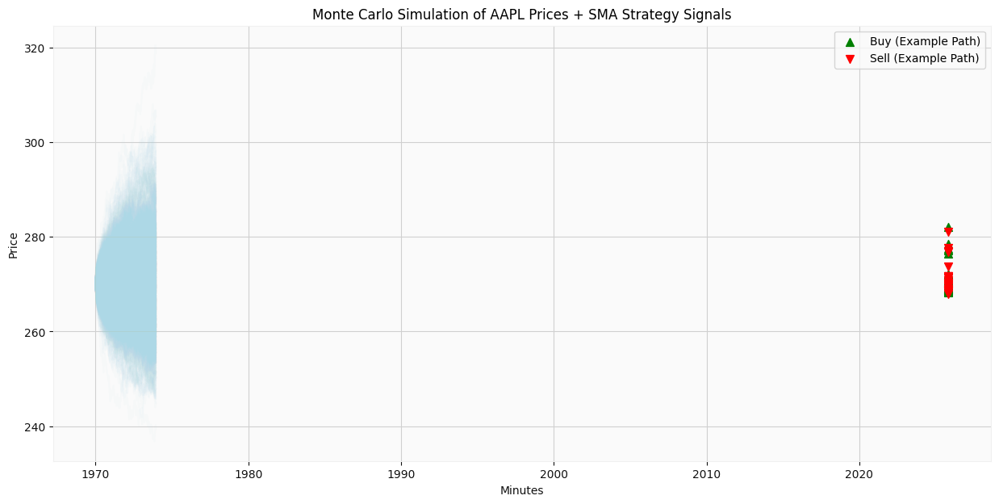

In [86]:
# --- Step 4: Plot Monte Carlo Paths with Buy/Sell Markers ---
plt.figure(figsize=(15,7))
for i in range(num_simulations):
    plt.plot(simulations[:,i], color='lightblue', alpha=0.05) # Plots all 1000 simulated price paths in faint blue (to visualize volatility).

# Plot buy/sell markers for first simulation as example
plt.scatter(buy_sell_paths[0][0].index, buy_sell_paths[0][0].values, marker='^', color='green', s=50, label='Buy (Example Path)')
# Plots the buy (green ↑) and sell (red ↓) points for the first simulation path as an example.
# buy_sell_paths[0][0] = buys
# buy_sell_paths[0][1] = sells
plt.scatter(buy_sell_paths[0][1].index, buy_sell_paths[0][1].values, marker='v', color='red', s=50, label='Sell (Example Path)')
plt.title('Monte Carlo Simulation of AAPL Prices + SMA Strategy Signals')
plt.xlabel('Minutes')
plt.ylabel('Price')
plt.legend()
plt.show()

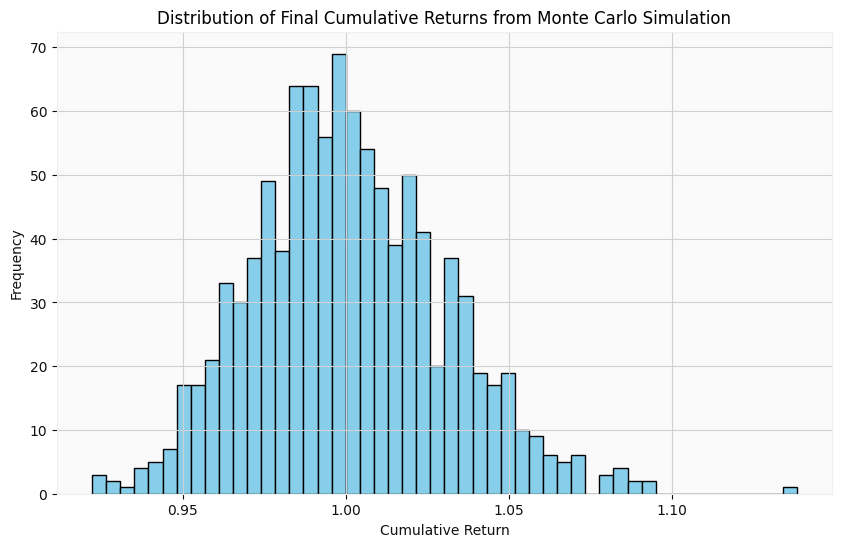

In [72]:
# --- Step 5: Plot PnL Distribution ---
plt.figure(figsize=(10,6))
plt.hist(pnl_results, bins=50, color='skyblue', edgecolor='black')
plt.title('Distribution of Final Cumulative Returns from Monte Carlo Simulation')
plt.xlabel('Cumulative Return')
plt.ylabel('Frequency')
plt.show()

# This visualizes risk distribution — how many scenarios you win or lose.

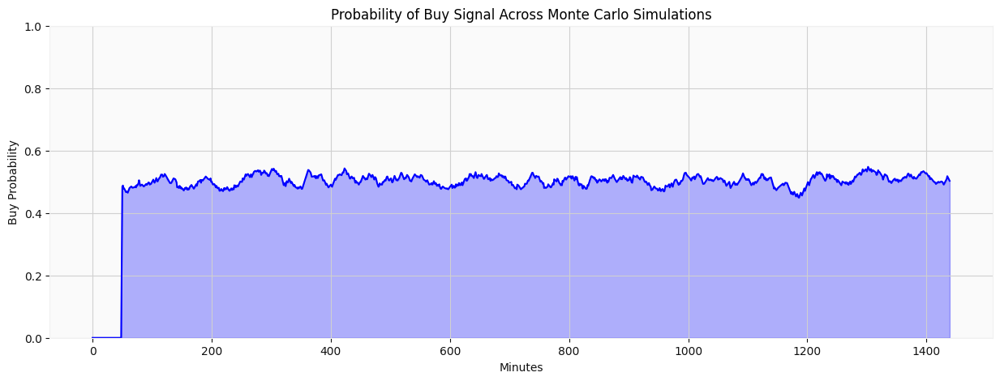

In [35]:
# --- Step 3: Track SMA signals for all paths ---
sma_short = 20
sma_long = 50

signal_matrix = np.zeros_like(simulations)  # 1 = buy, 0 = sell/cash
# simulations is a 2D NumPy array with shape (num_minutes, num_simulations).
            # Each column = one simulated price path.
            # Each row = price at a given minute.
# np.zeros_like(simulations) creates an array of the same shape filled with 0s.
            # These zeros will later store buy/sell signals:
                        #1 = buy signal (SMA20 > SMA50)
                        # 0 = sell/cash (SMA20 ≤ SMA50)
## This structure allows us to store the signal for every minute, across every simulated path — making it easy to compute statistics later.

for i in range(num_simulations):
    # Loop over each simulated path.
    sim_prices = pd.Series(simulations[:,i])
    # simulations[:, i] → takes all rows (prices over time) from the i-th simulation column.
    # We convert it into a pandas.Series to easily calculate moving averages with .rolling().
    
    sim_df = pd.DataFrame(sim_prices, columns=['Close'])
    # Create a DataFrame named sim_df with one column 'Close', representing simulated prices for that path.
    # This is similar to how you’d represent actual historical stock data (with close prices).
    
    sim_df['SMA20'] = sim_df['Close'].rolling(sma_short).mean()
    sim_df['SMA50'] = sim_df['Close'].rolling(sma_long).mean()
    # .rolling(window=n).mean() computes the n-period moving average.
    # It slides a window of size n along the data and takes the mean of those n values.
    # SMA20 is the average of the past 20 prices. SMA50 is the average of the past 50 prices.
    # The first few rows will be NaN because you need at least n values to calculate the moving average.
    
    sim_df.dropna(inplace=True)
    # Removes rows with NaN (which occur at the start before the first 20 or 50 points exist). This ensures we only use valid SMA comparisons.

    signal_matrix[sim_df.index[0]:, i] = (sim_df['SMA20'] > sim_df['SMA50']).astype(int)
    # (sim_df['SMA20'] > sim_df['SMA50']) returns a Boolean Series: True if SMA20 > SMA50 (bullish → buy); False otherwise (bearish → sell/cash)
    # .astype(int) converts True → 1, False → 0.
    # signal_matrix[sim_df.index[0]:, i] = 
                ##... inserts those 1s and 0s into the signal matrix starting from the first valid index (index[0] after dropping NaN rows).
    # So at the end of this loop, signal_matrix holds buy/sell signals for every minute and every simulation.

# --- Step 4: Compute probability of buy signal at each time ---
buy_probability = signal_matrix.mean(axis=1)
# axis=1 → take the mean across all simulations for each minute.
# Since signals are 1 or 0:
                ## The mean gives you the fraction of simulations that are currently giving a buy signal.
                ## Example: if 700 out of 1000 simulations have a buy signal → 0.7 (i.e., 70% buy probability).
# # So, buy_probability[t] = probability that the model suggests “buy” at minute t.


# --- Step 5: Plot Heatmap / Buy Probability ---
plt.figure(figsize=(15,5))
plt.plot(np.arange(num_minutes), buy_probability, color='blue') # x-axis = time (in minutes). # y-axis = probability (0 to 1).
plt.fill_between(np.arange(num_minutes), 0, buy_probability, color='blue', alpha=0.3) # shades the area under the curve for clarity.
plt.title('Probability of Buy Signal Across Monte Carlo Simulations')
plt.xlabel('Minutes')
plt.ylabel('Buy Probability')
plt.ylim(0,1)    # ensures the vertical scale runs from 0% to 100%.
plt.show()

In [93]:
print(buy_probability.mean())

0.48648125000000003


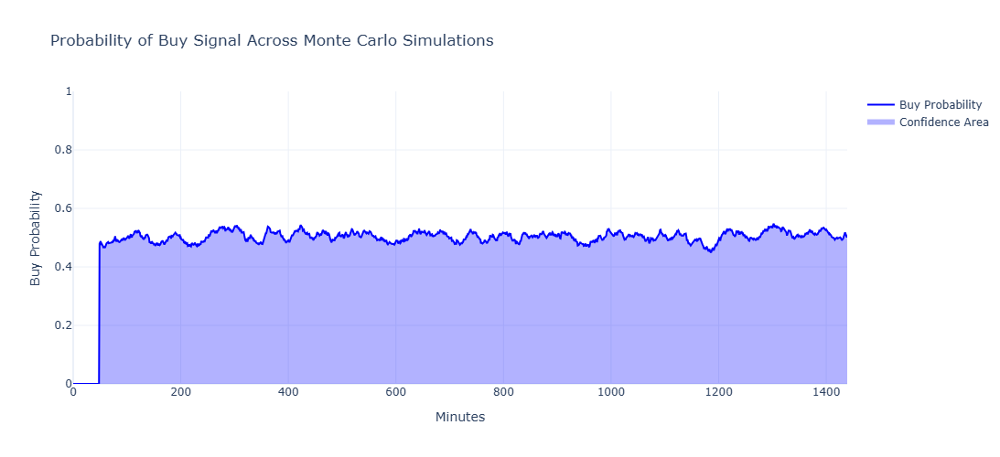

In [88]:
import plotly.graph_objects as go
import pandas as pd
import numpy as np

# --- Step 3: Track SMA signals for all paths ---
sma_short = 20
sma_long = 50

signal_matrix = np.zeros_like(simulations)  # 1 = buy, 0 = sell/cash

for i in range(num_simulations):
    sim_prices = pd.Series(simulations[:, i])
    df_sim = pd.DataFrame({'Close': sim_prices})
    
    # Calculate short and long moving averages
    df_sim['SMA20'] = df_sim['Close'].rolling(sma_short).mean()
    df_sim['SMA50'] = df_sim['Close'].rolling(sma_long).mean()
    
    # Remove NaN rows (from rolling window)
    df_sim.dropna(inplace=True)
    
    # Store buy signals (1 if SMA20 > SMA50, else 0)
    signal_matrix[df_sim.index[0]:, i] = (df_sim['SMA20'] > df_sim['SMA50']).astype(int)

# --- Step 4: Compute probability of buy signal at each time ---
buy_probability = signal_matrix.mean(axis=1)

# --- Step 5: Plot with Plotly ---
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=np.arange(len(buy_probability)),
    y=buy_probability,
    mode='lines',
    name='Buy Probability',
    line=dict(color='blue', width=2)
))

fig.add_trace(go.Scatter(
    x=np.arange(len(buy_probability)),
    y=buy_probability,
    fill='tozeroy',
    mode='none',
    fillcolor='rgba(0, 0, 255, 0.3)',
    name='Confidence Area'
))

fig.update_layout(
    title='Probability of Buy Signal Across Monte Carlo Simulations',
    xaxis_title='Minutes',
    yaxis_title='Buy Probability',
    yaxis=dict(range=[0, 1]),
    template='plotly_white',
    width=900,
    height=500
)

fig.show()


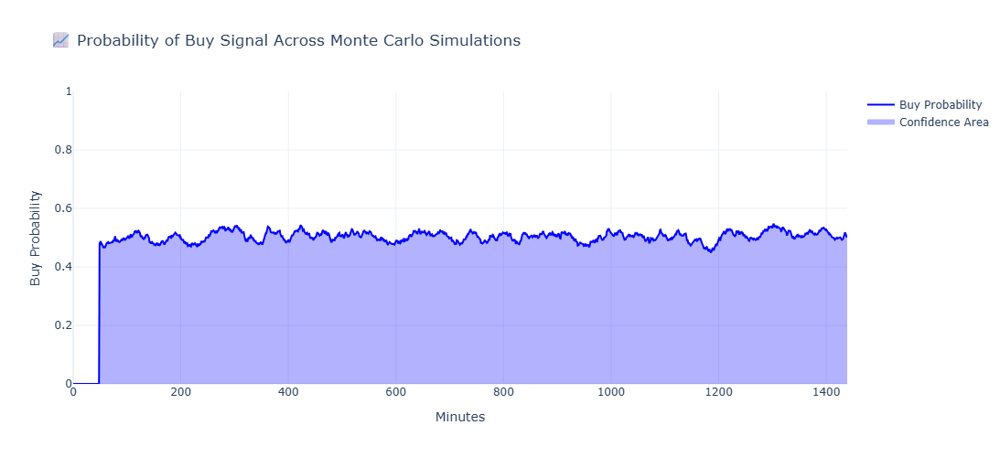

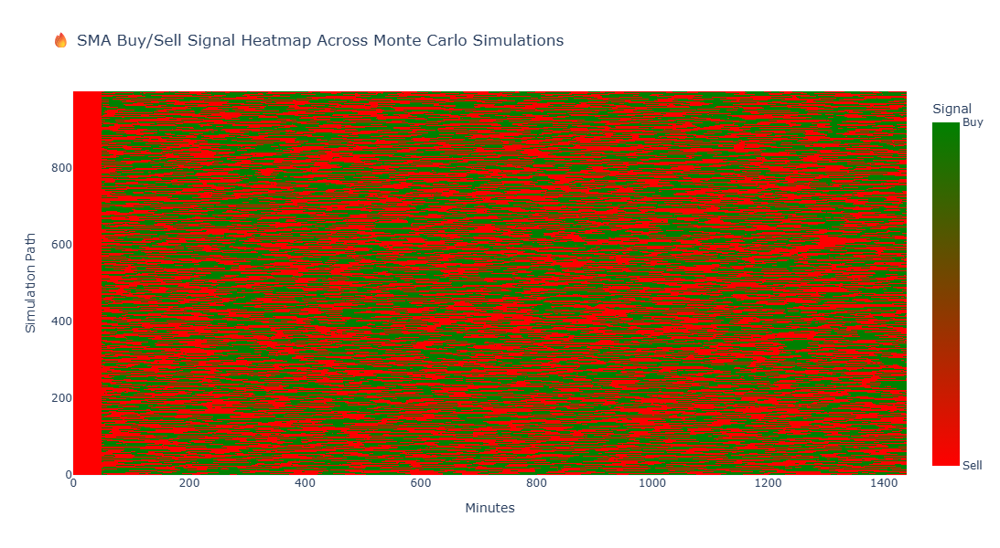

In [89]:
import plotly.graph_objects as go
import plotly.express as px
import pandas as pd
import numpy as np

# --- Step 3: Track SMA signals for all paths ---
sma_short = 20
sma_long = 50

signal_matrix = np.zeros_like(simulations)  # 1 = buy, 0 = sell/cash

for i in range(num_simulations):
    sim_prices = pd.Series(simulations[:, i])
    df_sim = pd.DataFrame({'Close': sim_prices})
    
    # Calculate short and long moving averages
    df_sim['SMA20'] = df_sim['Close'].rolling(sma_short).mean()
    df_sim['SMA50'] = df_sim['Close'].rolling(sma_long).mean()
    
    # Drop rows with NaN (due to rolling window)
    df_sim.dropna(inplace=True)
    
    # Mark buy signals (1 if SMA20 > SMA50 else 0)
    signal_matrix[df_sim.index[0]:, i] = (df_sim['SMA20'] > df_sim['SMA50']).astype(int)

# --- Step 4: Compute probability of buy signal at each time ---
buy_probability = signal_matrix.mean(axis=1)

# --- Step 5a: Interactive Line Plot for Buy Probability ---
fig1 = go.Figure()

fig1.add_trace(go.Scatter(
    x=np.arange(len(buy_probability)),
    y=buy_probability,
    mode='lines',
    name='Buy Probability',
    line=dict(color='blue', width=2)
))

fig1.add_trace(go.Scatter(
    x=np.arange(len(buy_probability)),
    y=buy_probability,
    fill='tozeroy',
    mode='none',
    fillcolor='rgba(0, 0, 255, 0.3)',
    name='Confidence Area'
))

fig1.update_layout(
    title='📈 Probability of Buy Signal Across Monte Carlo Simulations',
    xaxis_title='Minutes',
    yaxis_title='Buy Probability',
    yaxis=dict(range=[0, 1]),
    template='plotly_white',
    width=900,
    height=500
)

fig1.show()

# --- Step 5b: Interactive Heatmap for All Simulation Signals ---
fig2 = go.Figure(data=go.Heatmap(
    z=signal_matrix.T,  # transpose to have simulations on Y-axis
    colorscale=[[0, 'red'], [1, 'green']],  # red = sell, green = buy
    colorbar=dict(title='Signal', tickvals=[0, 1], ticktext=['Sell', 'Buy'])
))

fig2.update_layout(
    title='🔥 SMA Buy/Sell Signal Heatmap Across Monte Carlo Simulations',
    xaxis_title='Minutes',
    yaxis_title='Simulation Path',
    template='plotly_white',
    width=900,
    height=600
)

fig2.show()


C:\Users\USER\qiskit_env\Lib\site-packages\mplfinance\_arg_validators.py:84: UserWarning: 


            POSSIBLE TO SEE DETAILS (Candles, Ohlc-Bars, Etc.)
   For more information see:
   - https://github.com/matplotlib/mplfinance/wiki/Plotting-Too-Much-Data
   
   TO SILENCE THIS WARNING, set `type='line'` in `mpf.plot()`
   OR set kwarg `warn_too_much_data=N` where N is an integer 
   LARGER than the number of data points you want to plot.

  warnings.warn('\n\n ================================================================= '+


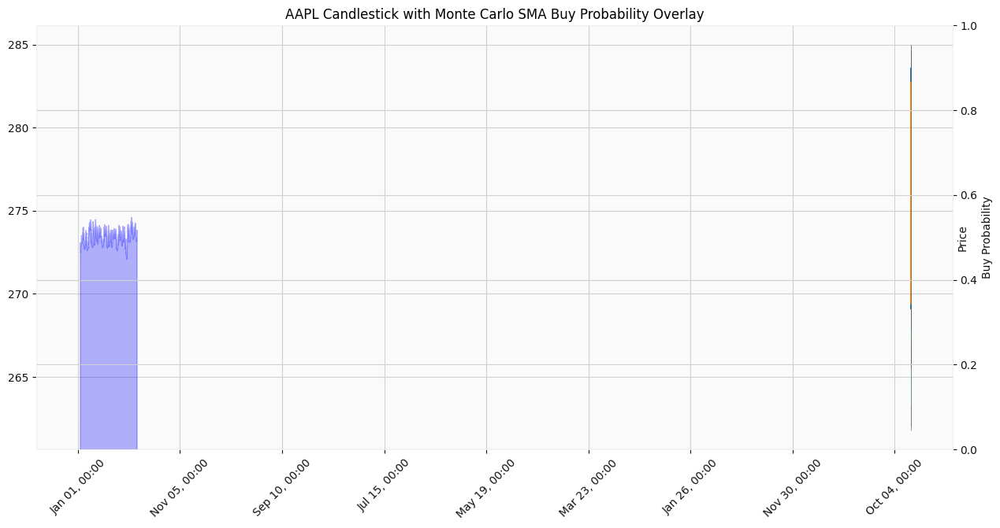

In [36]:
# --- Plot Candlestick + Buy Probability Heatmap ---
fig, ax1 = plt.subplots(figsize=(15,7))

# Candlestick chart
mpf.plot(df.iloc[-num_minutes:], type='candle', ax=ax1, volume=False, style='yahoo', mav=(20,50), show_nontrading=True)

# Overlay buy probability
ax2 = ax1.twinx()
ax2.fill_between(np.arange(num_minutes), 0, buy_probability, color='blue', alpha=0.3)
ax2.set_ylim(0,1)
ax2.set_ylabel('Buy Probability')
ax2.set_xlabel('Minutes')

plt.title('AAPL Candlestick with Monte Carlo SMA Buy Probability Overlay')
plt.show()

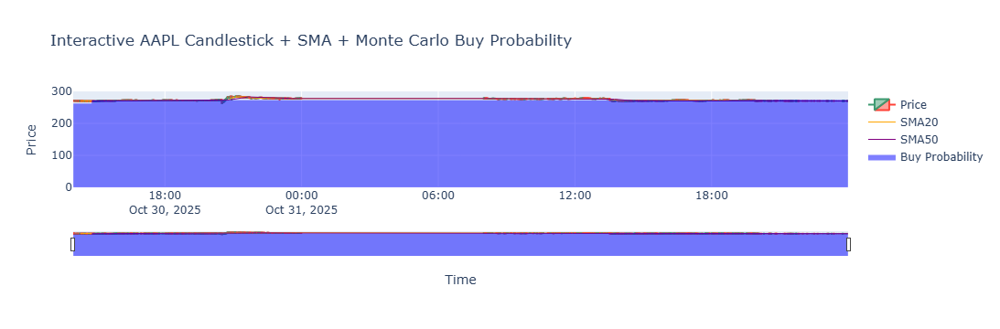

In [37]:
import plotly.graph_objects as go
# --- Step 4: Interactive Plot ---
fig = go.Figure()

# Candlestick
fig.add_trace(go.Candlestick(
    x=df.index[-num_minutes:], open=df['open'][-num_minutes:], high=df['high'][-num_minutes:],
    low=df['low'][-num_minutes:], close=df['close'][-num_minutes:],
    name='Price'
))

# SMA20
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=df['close'][-num_minutes:].rolling(sma_short).mean(),
    line=dict(color='orange', width=1), name='SMA20'
))

# SMA50
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=df['close'][-num_minutes:].rolling(sma_long).mean(),
    line=dict(color='purple', width=1), name='SMA50'
))

# Buy Probability (scaled to price range for overlay)
price_min, price_max = df['low'][-num_minutes:].min(), df['high'][-num_minutes:].max()
scaled_buy_prob = price_min + buy_probability*(price_max-price_min)
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=scaled_buy_prob,
    fill='tozeroy', line=dict(color='blue', width=0), name='Buy Probability', opacity=0.3,
    hovertemplate='Buy Prob: %{y:.2f}<extra></extra>'
))

fig.update_layout(
    title='Interactive AAPL Candlestick + SMA + Monte Carlo Buy Probability',
    yaxis_title='Price',
    xaxis_title='Time',
    hovermode='x unified'
)

fig.show()

In [94]:
# --- Track SMA signals for all simulations ---
sma_short = 20
sma_long = 50
signal_matrix = np.zeros_like(simulations)
cumulative_pnl_matrix = np.zeros_like(simulations)

for i in range(num_simulations):
    sim_prices = pd.Series(simulations[:,i])
    sim_df = pd.DataFrame(sim_prices, columns=['Close'])
    sim_df['SMA20'] = sim_df['Close'].rolling(sma_short).mean()
    sim_df['SMA50'] = sim_df['Close'].rolling(sma_long).mean()
    sim_df.dropna(inplace=True)
    sim_df['Position'] = 0
    sim_df['Position'][sim_df['SMA20'] > sim_df['SMA50']] = 1
    sim_df['Return'] = sim_df['Close'].pct_change() * sim_df['Position'].shift(1)
    sim_df['CumulativePnL'] = (1 + sim_df['Return'].dropna()).cumprod()
    
    # Align indices for matrix
    start_idx = num_minutes - len(sim_df)
    signal_matrix[start_idx:, i] = sim_df['Position'].values
    cumulative_pnl_matrix[start_idx:, i] = sim_df['CumulativePnL'].values

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\3320823440.py:14: FutureWarning:

ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\USER\AppData\Local\Temp\ipykernel_34148\3320823440.py:14: SettingWithCopyWarning:


A value is trying to be set on a co

In [45]:
# --- Compute probability of buy signal and expected PnL ---
buy_probability = signal_matrix.mean(axis=1)
expected_pnl = cumulative_pnl_matrix.mean(axis=1)

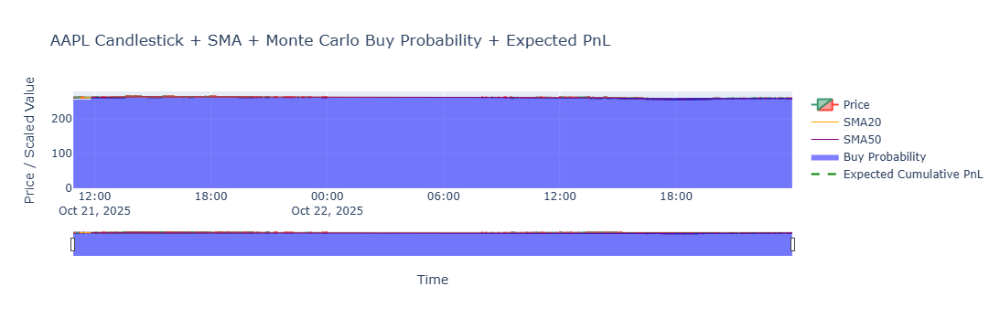

In [46]:
# --- Plot Interactive Dashboard ---
fig = go.Figure()

# Candlestick
fig.add_trace(go.Candlestick(
    x=df.index[-num_minutes:], open=df['open'][-num_minutes:], high=df['high'][-num_minutes:],
    low=df['low'][-num_minutes:], close=df['close'][-num_minutes:], name='Price'
))

# SMA20 & SMA50
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=df['close'][-num_minutes:].rolling(sma_short).mean(),
    line=dict(color='orange', width=1), name='SMA20'
))
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=df['close'][-num_minutes:].rolling(sma_long).mean(),
    line=dict(color='purple', width=1), name='SMA50'
))

# Buy Probability (scaled to price)
price_min, price_max = df['low'][-num_minutes:].min(), df['high'][-num_minutes:].max()
scaled_buy_prob = price_min + buy_probability*(price_max-price_min)
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=scaled_buy_prob,
    fill='tozeroy', line=dict(color='blue', width=0), name='Buy Probability', opacity=0.3,
    hovertemplate='Buy Prob: %{y:.2f}<extra></extra>'
))

# Expected cumulative PnL (scaled to price for overlay)
scaled_pnl = price_min + (expected_pnl-expected_pnl.min())/(expected_pnl.max()-expected_pnl.min())*(price_max-price_min)
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=scaled_pnl,
    line=dict(color='green', width=2, dash='dash'), name='Expected Cumulative PnL',
    hovertemplate='Expected PnL: %{y:.2f}<extra></extra>'
))

fig.update_layout(
    title='AAPL Candlestick + SMA + Monte Carlo Buy Probability + Expected PnL',
    yaxis_title='Price / Scaled Value',
    xaxis_title='Time',
    hovermode='x unified'
)

fig.show()

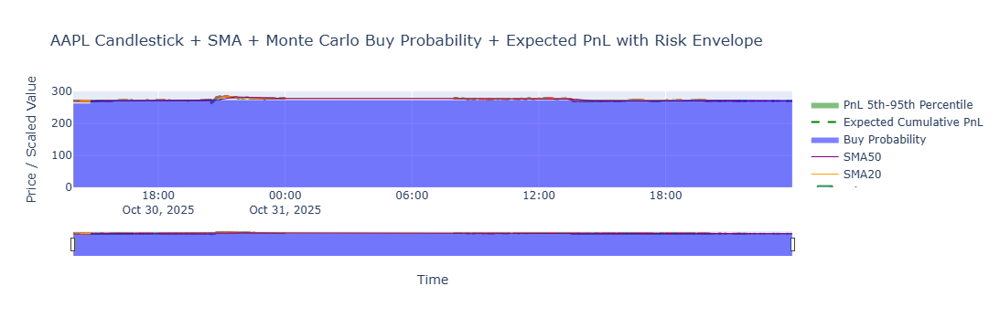

In [42]:
# --- Compute statistics ---
buy_probability = signal_matrix.mean(axis=1)
expected_pnl = cumulative_pnl_matrix.mean(axis=1)
pnl_5th = np.percentile(cumulative_pnl_matrix, 5, axis=1)
pnl_95th = np.percentile(cumulative_pnl_matrix, 95, axis=1)

# --- Plot Interactive Dashboard ---
fig = go.Figure()

# Candlestick
fig.add_trace(go.Candlestick(
    x=df.index[-num_minutes:], open=df['open'][-num_minutes:], high=df['high'][-num_minutes:],
    low=df['low'][-num_minutes:], close=df['close'][-num_minutes:], name='Price'
))

# SMA20 & SMA50
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=df['close'][-num_minutes:].rolling(sma_short).mean(),
    line=dict(color='orange', width=1), name='SMA20'
))
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=df['close'][-num_minutes:].rolling(sma_long).mean(),
    line=dict(color='purple', width=1), name='SMA50'
))

# Buy Probability (scaled)
price_min, price_max = df['low'][-num_minutes:].min(), df['high'][-num_minutes:].max()
scaled_buy_prob = price_min + buy_probability*(price_max-price_min)
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=scaled_buy_prob,
    fill='tozeroy', line=dict(color='blue', width=0), name='Buy Probability', opacity=0.3,
    hovertemplate='Buy Prob: %{y:.2f}<extra></extra>'
))

# Expected PnL (scaled)
scaled_expected_pnl = price_min + (expected_pnl-expected_pnl.min())/(expected_pnl.max()-expected_pnl.min())*(price_max-price_min)
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=scaled_expected_pnl,
    line=dict(color='green', width=2, dash='dash'), name='Expected Cumulative PnL',
    hovertemplate='Expected PnL: %{y:.2f}<extra></extra>'
))

# PnL Confidence Interval (shaded)
scaled_pnl_5th = price_min + (pnl_5th-pnl_5th.min())/(pnl_95th.max()-pnl_5th.min())*(price_max-price_min)
scaled_pnl_95th = price_min + (pnl_95th-pnl_5th.min())/(pnl_95th.max()-pnl_5th.min())*(price_max-price_min)
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=scaled_pnl_95th,
    fill=None, line=dict(color='green', width=0), showlegend=False
))
fig.add_trace(go.Scatter(
    x=df.index[-num_minutes:], y=scaled_pnl_5th,
    fill='tonexty', line=dict(color='green', width=0), name='PnL 5th-95th Percentile', opacity=0.2
))

fig.update_layout(
    title='AAPL Candlestick + SMA + Monte Carlo Buy Probability + Expected PnL with Risk Envelope',
    yaxis_title='Price / Scaled Value',
    xaxis_title='Time',
    hovermode='x unified'
)

fig.show()


In [43]:
df.head()

,open,high,low,close,volume,SMA20,SMA50,signal,crossover
timestamp,,,,,,,,,
2025-10-28 08:00:00,268.51,268.76,268.51,268.63,2563.0,NaN,NaN,False,True
2025-10-28 08:01:00,268.61,268.61,268.61,268.61,424.0,NaN,NaN,False,False
2025-10-28 08:03:00,268.75,268.75,268.75,268.75,740.0,NaN,NaN,False,False
2025-10-28 08:04:00,268.69,268.69,268.69,268.69,877.0,NaN,NaN,False,False
2025-10-28 08:05:00,268.68,268.68,268.68,268.68,344.0,NaN,NaN,False,False


In [44]:
import pandas as pd
import numpy as np

# 1. Minute-level OHLCV (already fetched from Polygon.io)
minute_df = df.copy()  # Open, High, Low, Close, Volume

# 2. Monte Carlo simulations (prices)
sim_df = pd.DataFrame(simulations, columns=[f'Sim_{i+1}' for i in range(simulations.shape[1])])

# 3. SMA signals for each simulation
sma_signal_df = pd.DataFrame(signal_matrix, columns=[f'Sim_{i+1}' for i in range(signal_matrix.shape[1])])

# 4. Buy probability
buy_prob_df = pd.DataFrame({'Buy_Probability': buy_probability})

# 5. Expected cumulative PnL and percentiles
pnl_df = pd.DataFrame({
    'Expected_PnL': expected_pnl,  # Expected_PnL: average or expected profit.
    'PnL_5th': pnl_5th,   # PnL_5th: pessimistic (5th percentile) PnL → “worst-case” scenario.
    'PnL_95th': pnl_95th   # PnL_95th: optimistic (95th percentile) PnL → “best-case” scenario.
})

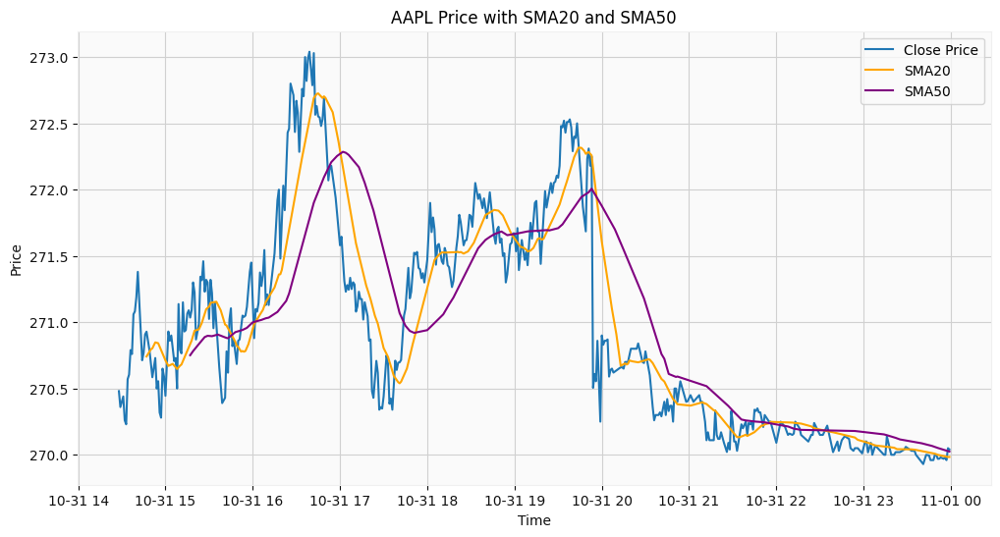

In [45]:
import matplotlib.pyplot as plt   
# Plots the last 500 minutes of price data.
plt.figure(figsize=(12,6))
plt.plot(minute_df['close'][-500:], label='Close Price')
plt.plot(minute_df['close'][-500:].rolling(20).mean(), label='SMA20', color='orange') 
# rolling(20).mean() → computes the 20-minute simple moving average.
plt.plot(minute_df['close'][-500:].rolling(50).mean(), label='SMA50', color='purple')
# rolling(50).mean() → computes the 50-minute simple moving average.
plt.title("AAPL Price with SMA20 and SMA50")
plt.xlabel("Time")
plt.ylabel("Price")
plt.legend()
plt.show()


# This plot visually confirms when the SMA20 crosses SMA50, marking potential buy/sell zones that drive the trading signals in simulations.

In [46]:
# Correlation between SMA20 > SMA50 and forward return
# “Does the SMA20>SMA50 signal actually predict future price changes?”
forward_return = minute_df['close'].pct_change().shift(-1)
signal = (minute_df['close'].rolling(20).mean() > minute_df['close'].rolling(50).mean()).astype(int)
corr = signal.corr(forward_return)
print("Correlation between SMA20>SMA50 and next-minute return:", corr)

Correlation between SMA20>SMA50 and next-minute return: -0.020849435578871284


**The goal is to measure how strongly the SMA crossover signal (SMA20 > SMA50) correlates with the next-minute return of the stock.
In other words — “Does the SMA20>SMA50 signal actually predict future price changes?”**

## forward_return = minute_df['close'].pct_change().shift(-1)
- minute_df['close'].pct_change() Calculates the percentage change between consecutive closing prices.
- Formula:
          $$
\mathrm{Return}_t = \frac{P_t - P_{t-1}}{P_{t-1}}
$$

where $P_t$ is the close price at time $t$.

*So now, each value shows the return from the previous minute to the current minute.*

## .shift(-1)
- Shifts all values one step upward, so that each row now represents the return for the next minute.
- Example:
| Time | Close | pct_change | shift(-1) |
| ---- | ----- | ---------- | --------- |
| $t_1$ | 100   | —          | 0.01      |
| $t_2$ | 101   | 0.01       | -0.02     |
| $t_3$ | 99    | -0.02      | ...       |

**✅ Result:
forward_return now shows how much the price changed in the next minute, not the previous one — perfect for predicting future movement.**

## corr = signal.corr(forward_return)
- .corr() computes the Pearson correlation coefficient between two variables:
- signal (our SMA crossover state)
- forward_return (the next-minute return)

**Interpretation:
The correlation measures how strongly a change in one variable relates to changes in another:**
| Correlation Value | Interpretation               |
| ----------------- | ---------------------------- |
| +1.0              | Perfect positive correlation |
| 0.0               | No correlation               |
| -1.0              | Perfect negative correlation |


**🧾 Result Interpretation**
- Value = -0.02
- This is very close to 0, meaning almost no correlation.
- The slightly negative value (−0.02) suggests that when SMA20 > SMA50, the next-minute return tends to be marginally negative on average — but it’s statistically insignificant.

**✅ In simple terms:
The SMA20 > SMA50 crossover does not meaningfully predict what happens in the very next minute.
It’s a longer-term signal — better suited for hourly, daily, or swing trading timeframes, not minute-by-minute scalping.**

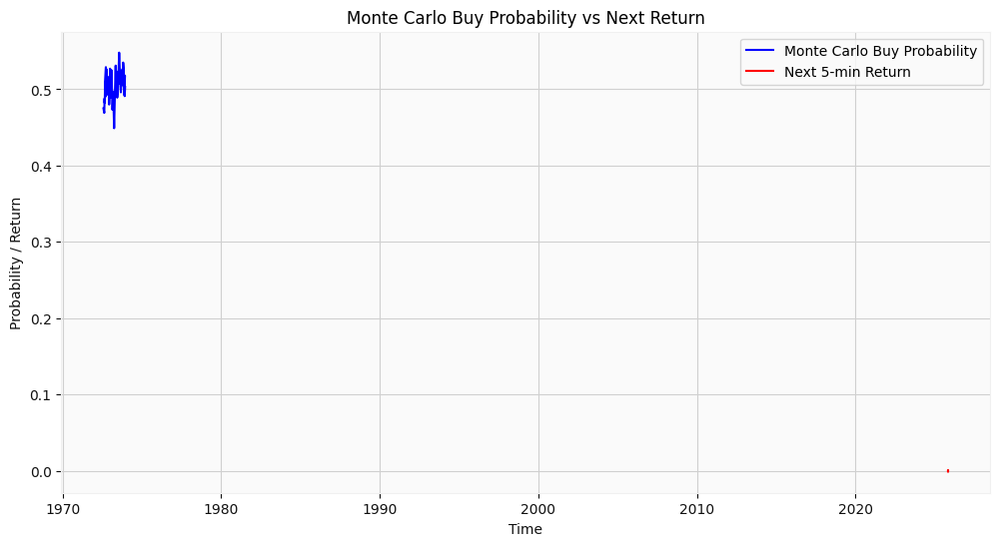

Correlation between Buy Probability and Next 5-min Return: nan


In [47]:
plt.figure(figsize=(12,6))
plt.plot(buy_prob_df['Buy_Probability'][-500:], label='Monte Carlo Buy Probability', color='blue')
plt.plot(minute_df['close'][-500:].pct_change().shift(-1).rolling(5).mean(), label='Next 5-min Return', color='red')
plt.title("Monte Carlo Buy Probability vs Next Return")
plt.xlabel("Time")
plt.ylabel("Probability / Return")
plt.legend()
plt.show()

print("Correlation between Buy Probability and Next 5-min Return:", 
      buy_prob_df['Buy_Probability'].corr(minute_df['close'].pct_change().shift(-1).rolling(5).mean()))


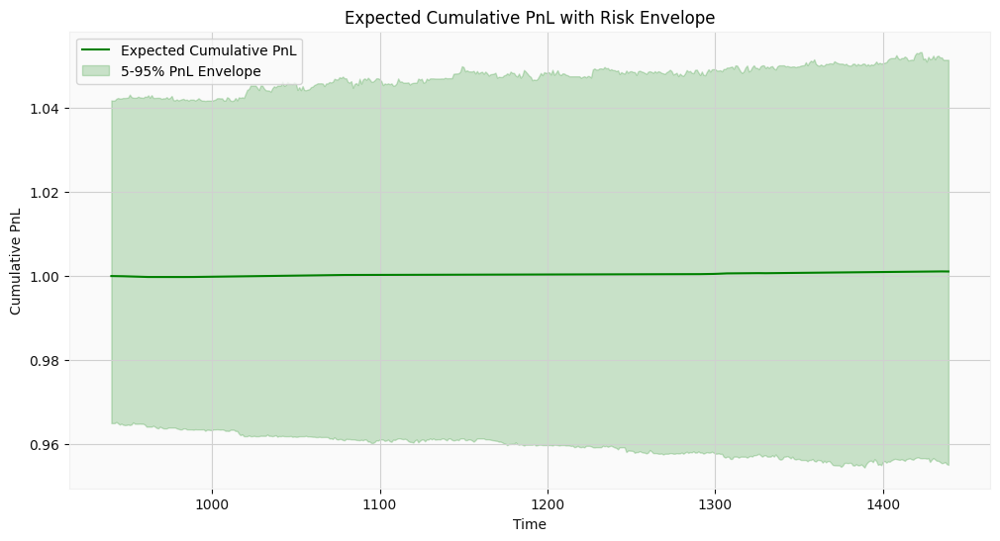

Mean Expected PnL: 0.9661092448908308
Std of Expected PnL: 0.18145477122191597


In [48]:
plt.figure(figsize=(12,6))
plt.plot(pnl_df['Expected_PnL'][-500:], label='Expected Cumulative PnL', color='green')
plt.fill_between(pnl_df.index[-500:], pnl_df['PnL_5th'][-500:], pnl_df['PnL_95th'][-500:], color='green', alpha=0.2, label='5-95% PnL Envelope')
plt.title("Expected Cumulative PnL with Risk Envelope")
plt.xlabel("Time")
plt.ylabel("Cumulative PnL")
plt.legend()
plt.show()

# Basic stats
print("Mean Expected PnL:", pnl_df['Expected_PnL'].mean())
print("Std of Expected PnL:", pnl_df['Expected_PnL'].std())

- The mean PnL ≈ 0.97 means that, on average, your cumulative return ends slightly below 1 (a small net loss or near breakeven).

- The standard deviation (0.18) shows moderate variability — your PnL fluctuates about ±18% from the mean across different simulations.

**“On average, my trading strategy yields roughly no profit (0.97x) after all simulations, with a moderate variability (±0.18).
Most outcomes (90%) lie within the shaded green zone — giving a sense of the expected range of performance.”**

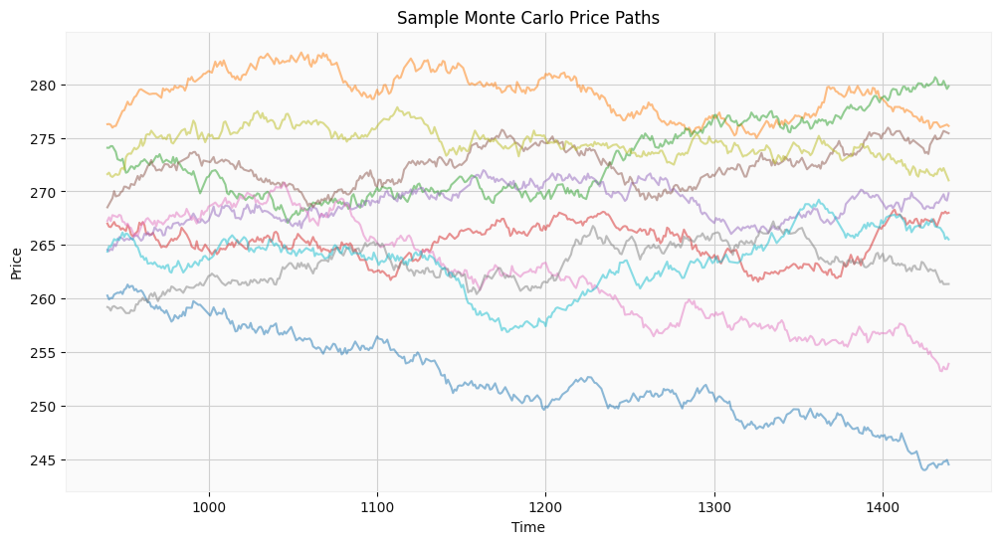

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\4017709759.py:15: UserWarning:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



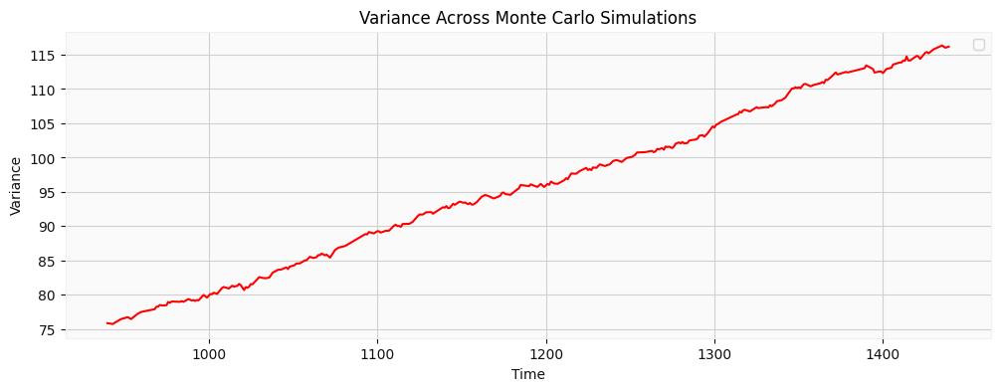

In [50]:
plt.figure(figsize=(12,6))
plt.plot(sim_df.iloc[-500:, :10], alpha=0.5)
# Plot last 500 points from first 10 simulations
plt.title("Sample Monte Carlo Price Paths")
plt.xlabel("Time")
plt.ylabel("Price")
plt.show()

# Variance across simulations at each minute
sim_variance = sim_df.var(axis=1)
plt.figure(figsize=(12,4))
plt.plot(sim_variance[-500:], color='red')
plt.title("Variance Across Monte Carlo Simulations")
plt.xlabel("Time")
plt.ylabel("Variance")
plt.legend()
plt.show()

# First Figure

## 💡 Interpretation

**This plot helps you visually assess:**

- Volatility → How spread out or variable the simulated price paths are.

- Trend direction → Whether most paths tend to drift upward (bullish) or downward (bearish).

- Uncertainty → How quickly the range of possible outcomes widens.

- If paths diverge significantly, it means your simulation model (e.g., using geometric Brownian motion) expects high uncertainty or volatility in future prices.

## Starting portfolio optimization with qiskit, aer, QAE, QAOA, quantum monte carlo, black scholes

In [51]:
daily_df = df.copy()

In [52]:
daily_df.head()

,open,high,low,close,volume,SMA20,SMA50,signal,crossover
timestamp,,,,,,,,,
2025-10-28 08:00:00,268.51,268.76,268.51,268.63,2563.0,NaN,NaN,False,True
2025-10-28 08:01:00,268.61,268.61,268.61,268.61,424.0,NaN,NaN,False,False
2025-10-28 08:03:00,268.75,268.75,268.75,268.75,740.0,NaN,NaN,False,False
2025-10-28 08:04:00,268.69,268.69,268.69,268.69,877.0,NaN,NaN,False,False
2025-10-28 08:05:00,268.68,268.68,268.68,268.68,344.0,NaN,NaN,False,False


In [53]:
daily_df = daily_df.resample('1D').agg({
    'open':'first',
    'high':'max',
    'low':'min',
    'close':'last',
    'volume':'sum'
})

In [54]:
daily_df.head()

,open,high,low,close,volume
timestamp,,,,,
2025-10-28,268.51,269.89,267.82,268.35,35010591.0
2025-10-29,269.40,271.41,267.11,270.91,40704970.0
2025-10-30,271.05,285.00,261.79,277.75,62409115.0
2025-10-31,278.12,279.50,269.16,270.04,66684064.0


In [55]:
import math
import pandas as pd
import numpy as np
# from qiskit_aer import AerSimulator
# from qiskit.utils import QuantumInstance
# from qiskit.algorithms import IterativeAmplitudeEstimation, EstimationProblem
# from qiskit.circuit import QuantumCircuit

from qiskit_aer import AerSimulator
# from qiskit.utils import QuantumInstance
from qiskit.algorithms import IterativeAmplitudeEstimation, EstimationProblem
from qiskit.circuit import QuantumCircuit



# -------------------------------------------------
# 1) Assume df and daily_df are already created by your code
# -------------------------------------------------
# daily_df = df.resample('1D').agg({...})   <-- from your code above

# Drop rows with NaN (e.g., weekend gaps)
daily_df.dropna(inplace=True)

# -------------------------------------------------
# 2) Compute returns and PositiveReturn indicator
# -------------------------------------------------
daily_df['return'] = daily_df['close'].pct_change()
daily_df.dropna(inplace=True)
daily_df['PositiveReturn'] = (daily_df['return'] > 0).astype(int)

print("\nDaily data with returns and indicator:")
print(daily_df[['open','close','return','PositiveReturn']])

# -------------------------------------------------
# 3) Classical probability of positive return
# -------------------------------------------------
p_classical = daily_df['PositiveReturn'].mean()
print(f"\nClassical probability (empirical): {p_classical:.6f}")

# -------------------------------------------------
# 4) Build quantum circuit that encodes this probability
# -------------------------------------------------
theta = 2 * math.asin(math.sqrt(p_classical))   # rotation angle
qc = QuantumCircuit(1)
qc.ry(theta, 0)

print("\nState preparation circuit:")
print(qc.draw(output='text'))

# -------------------------------------------------
# 5) QAE with IterativeAmplitudeEstimation
# -------------------------------------------------
problem = EstimationProblem(state_preparation=qc, objective_qubits=[0])

backend = Aer.get_backend('aer_simulator')
qi = QuantumInstance(backend, shots=2000)

iae = IterativeAmplitudeEstimation(
    epsilon_target=0.01,  # precision target
    alpha=0.05,           # confidence level (95%)
    quantum_instance=qi
)

print("\nRunning QAE...")
result = iae.estimate(problem)

print("\nQAE Results:")
print(f"Estimated probability: {result.estimation:.6f}")
print(f"Confidence interval: {result.confidence_interval}")
print(f"Classical (empirical) probability: {p_classical:.6f}")


C:\Users\USER\AppData\Local\Temp\ipykernel_34148\4158030448.py:11: DeprecationWarning:

``qiskit.algorithms`` has been migrated to an independent package: https://github.com/qiskit-community/qiskit-algorithms. The ``qiskit.algorithms`` import path is deprecated as of qiskit-terra 0.25.0 and will be removed no earlier than 3 months after the release date. Please run ``pip install qiskit_algorithms`` and use ``import qiskit_algorithms`` instead.




Daily data with returns and indicator:
              open   close    return  PositiveReturn
timestamp                                           
2025-10-29  269.40  270.91  0.009540               1
2025-10-30  271.05  277.75  0.025248               1
2025-10-31  278.12  270.04 -0.027759               0

Classical probability (empirical): 0.666667

State preparation circuit:
   ┌────────────┐
q: ┤ Ry(1.9106) ├
   └────────────┘


NameError: name 'Aer' is not defined

In [56]:
import math
import pandas as pd

from qiskit_aer import AerSimulator
from qiskit.utils import QuantumInstance
from qiskit.algorithms import IterativeAmplitudeEstimation, EstimationProblem
from qiskit.circuit import QuantumCircuit

# Example dummy data
daily_df = pd.DataFrame({
    'open': [100, 102, 101, 103],
    'close': [102, 101, 103, 104]
})

# Compute returns and PositiveReturn
daily_df['return'] = daily_df['close'].pct_change()
daily_df.dropna(inplace=True)
daily_df['PositiveReturn'] = (daily_df['return'] > 0).astype(int)

# Classical probability
p_classical = daily_df['PositiveReturn'].mean()
theta = 2 * math.asin(math.sqrt(p_classical))

# Quantum circuit
qc = QuantumCircuit(1)
qc.ry(theta, 0)
print(qc.draw(output='text'))

# QAE setup
problem = EstimationProblem(state_preparation=qc, objective_qubits=[0])
backend = AerSimulator()
qi = QuantumInstance(backend, shots=2000)

iae = IterativeAmplitudeEstimation(
    epsilon_target=0.01,
    alpha=0.05,
    quantum_instance=qi
)

result = iae.estimate(problem)
print("Estimated probability:", result.estimation)
print("Confidence interval:", result.confidence_interval)
print("Classical probability:", p_classical)


   ┌────────────┐
q: ┤ Ry(1.9106) ├
   └────────────┘


C:\Users\USER\AppData\Local\Temp\ipykernel_34148\3174356682.py:32: DeprecationWarning:

The class ``qiskit.utils.quantum_instance.QuantumInstance`` is deprecated as of qiskit-terra 0.24.0. It will be removed no earlier than 3 months after the release date. For code migration guidelines, visit https://qisk.it/qi_migration.

C:\Users\USER\qiskit_env\Lib\site-packages\qiskit\providers\ibmq\api\session.py:19: UserWarning:

pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\3174356682.py:34: DeprecationWarning:

``qiskit.algorithms.amplitude_estimators.iae.IterativeAmplitudeEstimation.__init__()``'s argument ``quantum_instance`` is deprecated as of qiskit-terra 0.24.0. It will be removed no earlier than 3 months after the release date. Instead, use the ``sampler`` ar

Estimated probability: 0.6671706523469398
Confidence interval: (0.6656668098038638, 0.668674494890016)
Classical probability: 0.6666666666666666


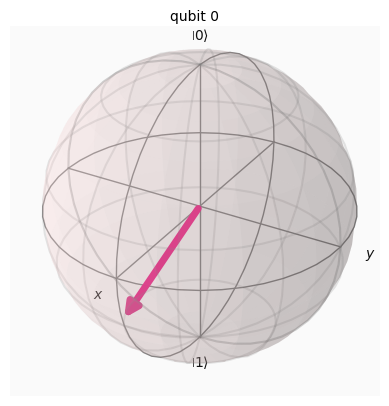

In [95]:
from qiskit import QuantumCircuit
from qiskit.visualization import plot_bloch_multivector
from qiskit.quantum_info import Statevector
import math

# Classical probability (from your data)
p_classical = 0.6667
theta = 2 * math.asin(math.sqrt(p_classical))

# Build the circuit
qc = QuantumCircuit(1)
qc.ry(theta, 0)

# Get the final quantum state
state = Statevector.from_instruction(qc)

# Visualize on Bloch sphere
plot_bloch_multivector(state)


In [57]:
import math
import pandas as pd
# from qiskit.circuit import QuantumCircuit
# from qiskit.algorithms import IterativeAmplitudeEstimation, EstimationProblem
# from qiskit_aer import AerSimulator

from qiskit import Aer
from qiskit.utils import QuantumInstance
from qiskit.algorithms.amplitude_estimators import IterativeAmplitudeEstimation, EstimationProblem
from qiskit.circuit import QuantumCircuit


# -------------------------------------------------
# 1) Example: Your daily stock data (replace with your actual df)
# -------------------------------------------------
# Assume df has columns: ['Open', 'Close'] and a datetime index
data = {
    'open': [100, 102, 101, 103, 104],
    'close': [102, 101, 103, 104, 105]
}
daily_df = pd.DataFrame(data)

# Drop rows with NaN (if any, e.g., from weekends)
daily_df.dropna(inplace=True)

# -------------------------------------------------
# 2) Compute returns and PositiveReturn indicator
# -------------------------------------------------
daily_df['return'] = daily_df['close'].pct_change()
daily_df.dropna(inplace=True)
daily_df['PositiveReturn'] = (daily_df['return'] > 0).astype(int)

print("\nDaily data with returns and indicator:")
print(daily_df[['open','close','return','PositiveReturn']])

# -------------------------------------------------
# 3) Classical probability of positive return
# -------------------------------------------------
p_classical = daily_df['PositiveReturn'].mean()
print(f"\nClassical probability (empirical): {p_classical:.6f}")

# -------------------------------------------------
# 4) Build quantum circuit encoding this probability
# -------------------------------------------------
theta = 2 * math.asin(math.sqrt(p_classical))   # rotation angle
qc = QuantumCircuit(1)
qc.ry(theta, 0)

print("\nState preparation circuit:")
print(qc.draw(output='text'))

# -------------------------------------------------
# 5) QAE with IterativeAmplitudeEstimation
# -------------------------------------------------
problem = EstimationProblem(state_preparation=qc, objective_qubits=[0])

# Use AerSimulator as backend
backend = AerSimulator()

iae = IterativeAmplitudeEstimation(
    epsilon_target=0.01,  # desired precision
    alpha=0.05,           # 95% confidence interval
    quantum_instance=backend  # pass backend directly in Qiskit 0.25+
)

print("\nRunning QAE...")
result = iae.estimate(problem)

# -------------------------------------------------
# 6) Print results
# -------------------------------------------------
print("\nQAE Results:")
print(f"Estimated probability: {result.estimation:.6f}")
print(f"Confidence interval: {result.confidence_interval}")
print(f"Classical (empirical) probability: {p_classical:.6f}")



Daily data with returns and indicator:
   open  close    return  PositiveReturn
1   102    101 -0.009804               0
2   101    103  0.019802               1
3   103    104  0.009709               1
4   104    105  0.009615               1

Classical probability (empirical): 0.750000

State preparation circuit:
   ┌──────────┐
q: ┤ Ry(2π/3) ├
   └──────────┘

Running QAE...

QAE Results:
Estimated probability: 0.751342
Confidence interval: (0.7479985775051144, 0.7546854085994067)
Classical (empirical) probability: 0.750000


C:\Users\USER\AppData\Local\Temp\ipykernel_34148\2529671184.py:60: DeprecationWarning:

``qiskit.algorithms.amplitude_estimators.iae.IterativeAmplitudeEstimation.__init__()``'s argument ``quantum_instance`` is deprecated as of qiskit-terra 0.24.0. It will be removed no earlier than 3 months after the release date. Instead, use the ``sampler`` argument. See https://qisk.it/algo_migration for a migration guide.



In [58]:
import numpy as np
import pandas as pd
from qiskit import QuantumCircuit
from qiskit_aer.primitives import Sampler
from qiskit.algorithms.amplitude_estimators import IterativeAmplitudeEstimation, EstimationProblem

# Example returns (replace with your daily returns)
returns = np.array([0.01, -0.005, 0.002, -0.008, 0.012])

# 95% Value at Risk (VaR) threshold (classical)
alpha = 0.05
VaR_classical = np.quantile(returns, alpha)
print("Classical 95% VaR:", VaR_classical)

# Define probability: P(Return < VaR)
p = np.mean(returns < VaR_classical)

# Quantum encoding circuit
theta = 2 * np.arcsin(np.sqrt(p))
qc = QuantumCircuit(1)
qc.ry(theta, 0)

problem = EstimationProblem(
    state_preparation=qc,
    objective_qubits=[0]
)

# Sampler with AerSimulator backend
sampler = Sampler()

# Iterative Amplitude Estimation
iae = IterativeAmplitudeEstimation(
    epsilon_target=0.01,
    alpha=0.05,
    sampler=sampler
)

result = iae.estimate(problem)

print("\nQAE Results:")
print("Estimated probability (Return < VaR):", result.estimation)
print("Confidence interval:", result.confidence_interval)
print("Classical probability:", p)


Classical 95% VaR: -0.0074

QAE Results:
Estimated probability (Return < VaR): 0.201131034064995
Confidence interval: (0.19848035698709143, 0.20378171114289859)
Classical probability: 0.2


In [59]:
import numpy as np
import pandas as pd
import math

# Qiskit imports
from qiskit import QuantumCircuit
from qiskit_aer.primitives import Sampler
from qiskit.algorithms.amplitude_estimators import IterativeAmplitudeEstimation, EstimationProblem

# -------------------------------------------------
# 1) Assume you already built daily_df from Polygon API
# -------------------------------------------------
# daily_df has at least: ['Open','Close']
# Example fallback if not available:
# data = {'Open': [100, 102, 101, 103, 104],
#         'Close': [102, 101, 103, 104, 105]}
# daily_df = pd.DataFrame(data)

# Compute daily returns
daily_df['return'] = daily_df['close'].pct_change()
daily_df.dropna(inplace=True)

# -------------------------------------------------
# 2) Classical 95% Value at Risk (VaR)
# -------------------------------------------------
alpha = 0.05
VaR_classical = np.quantile(daily_df['return'], alpha)
print("Classical 95% VaR:", VaR_classical)

# Probability that return < VaR
p_classical = np.mean(daily_df['return'] < VaR_classical)
print("Classical probability (return < VaR):", p_classical)

# -------------------------------------------------
# 3) Quantum encoding of probability
# -------------------------------------------------
# Encode probability into rotation angle
theta = 2 * math.asin(math.sqrt(p_classical))
qc = QuantumCircuit(1)
qc.ry(theta, 0)

print("\nState preparation circuit:")
print(qc.draw(output='text'))

# -------------------------------------------------
# 4) Build EstimationProblem
# -------------------------------------------------
problem = EstimationProblem(
    state_preparation=qc,
    objective_qubits=[0]
)

# -------------------------------------------------
# 5) Run Iterative Amplitude Estimation (IAE)
# -------------------------------------------------
sampler = Sampler()  # uses AerSimulator internally

iae = IterativeAmplitudeEstimation(
    epsilon_target=0.01,  # precision
    alpha=0.05,           # 95% confidence level
    sampler=sampler
)

print("\nRunning QAE...")
result = iae.estimate(problem)

# -------------------------------------------------
# 6) Results
# -------------------------------------------------
print("\nQAE Results:")
print("Estimated probability (Return < VaR):", result.estimation)
print("Confidence interval:", result.confidence_interval)
print("Classical probability:", p_classical)


Classical 95% VaR: 0.009624719940253889
Classical probability (return < VaR): 0.3333333333333333

State preparation circuit:
   ┌───────────┐
q: ┤ Ry(1.231) ├
   └───────────┘

Running QAE...

QAE Results:
Estimated probability (Return < VaR): 0.3342397369503919
Confidence interval: (0.3318778913886042, 0.33660158251217953)
Classical probability: 0.3333333333333333


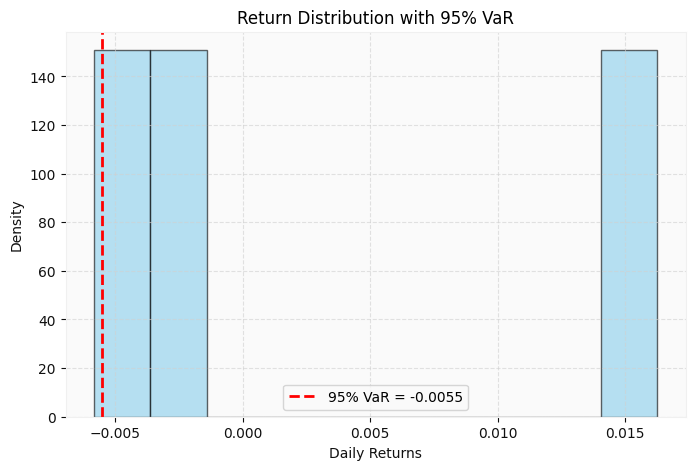

In [60]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Example daily returns (replace with your actual daily_df['Return'])
returns = np.array([0.016265, -0.002693, -0.005832])  # sample from your dataset

# Compute 5% VaR
alpha = 0.05
VaR = np.quantile(returns, alpha)

# Plot histogram
plt.figure(figsize=(8,5))
plt.hist(returns, bins=10, alpha=0.6, color='skyblue', edgecolor='black', density=True)

# Add VaR line
plt.axvline(VaR, color='red', linestyle='--', linewidth=2, label=f"95% VaR = {VaR:.4f}")

# Labels and legend
plt.title("Return Distribution with 95% VaR")
plt.xlabel("Daily Returns")
plt.ylabel("Density")
plt.legend()
plt.grid(True, linestyle="--", alpha=0.6)
plt.show()


In [61]:
# 2_qae_var_cvar.py
import numpy as np, pandas as pd, math
# ensure daily_df exists
returns = daily_df['return'].to_numpy()

# classical VaR and CVaR
alpha = 0.05
VaR = np.quantile(returns, alpha)
cvar = returns[returns <= VaR].mean() if np.any(returns <= VaR) else VaR
print("Classical VaR (alpha=%.2f):" % alpha, VaR)
print("Classical CVaR (ES):", cvar)

# classical tail probability
p_classical = np.mean(returns < VaR)
print("Classical P(return < VaR):", p_classical)

# Quantum: use IterativeAmplitudeEstimation to estimate p = P(return < VaR)
try:
    from qiskit import QuantumCircuit
    from qiskit_aer.primitives import Sampler
    from qiskit.algorithms.amplitude_estimators import IterativeAmplitudeEstimation, EstimationProblem

    # Build single-qubit encoding of p_classical (Bernoulli demonstration)
    theta = 2 * math.asin(math.sqrt(p_classical))
    qc = QuantumCircuit(1)
    qc.ry(theta, 0)

    problem = EstimationProblem(state_preparation=qc, objective_qubits=[0])
    sampler = Sampler()
    iae = IterativeAmplitudeEstimation(epsilon_target=0.01, alpha=0.05, sampler=sampler)
    res = iae.estimate(problem)
    print("QAE estimated probability:", res.estimation)
    print("QAE confidence interval:", res.confidence_interval)
except Exception as e:
    print("QAE/IAE step failed or qiskit missing:", e)
    print('Install (in terminal/notebook cell) and restart kernel: !pip install "qiskit==0.45.0" "qiskit-aer==0.13.3"')


Classical VaR (alpha=0.05): 0.009624719940253889
Classical CVaR (ES): 0.009615384615384581
Classical P(return < VaR): 0.3333333333333333
QAE estimated probability: 0.33445024431948644
QAE confidence interval: (0.3307986971521231, 0.3381017914868498)


In [62]:
# 3_derivative_pricing_mc_qae.py
import numpy as np, pandas as pd
S0 = daily_df['close'].iloc[-1]
# params
T_days = 30
mu = daily_df['return'].mean()
sigma = daily_df['return'].std()
n_sims = 20000
K = S0 * 1.02  # strike 2% above spot

# Classical Monte Carlo
rng = np.random.default_rng(42)
final_prices = []
for i in range(n_sims):
    prices = S0
    for t in range(T_days):
        prices *= np.exp(rng.normal(mu, sigma))
    final_prices.append(prices)
final_prices = np.array(final_prices)
payoffs = np.maximum(final_prices - K, 0)
classical_price = np.exp(0) * np.mean(payoffs)  # ignoring discounting
print("Classical MC option price (estimate):", classical_price)

# QAE demonstration: estimate probability payoff>0 (indicator)
p_indicator = np.mean(payoffs > 0)
print("Classical probability payoff>0:", p_indicator)

try:
    from qiskit import QuantumCircuit
    from qiskit_aer.primitives import Sampler
    from qiskit.algorithms.amplitude_estimators import IterativeAmplitudeEstimation, EstimationProblem
    import math

    theta = 2 * math.asin(math.sqrt(p_indicator))
    qc = QuantumCircuit(1); qc.ry(theta, 0)
    problem = EstimationProblem(state_preparation=qc, objective_qubits=[0])
    sampler = Sampler()
    iae = IterativeAmplitudeEstimation(epsilon_target=0.01, alpha=0.05, sampler=sampler)
    res = iae.estimate(problem)
    print("QAE estimated P(payoff>0):", res.estimation, "CI:", res.confidence_interval)
    # To get expected payoff (not just indicator) you'd need amplitude oracle encoding normalized payoff values.
except Exception as e:
    print("QAE step failed or qiskit not available:", e)


Classical MC option price (estimate): 48.224841346246016
Classical probability payoff>0: 1.0
QAE estimated P(payoff>0): 0.9999937668292904 CI: (0.9999875336585808, 1.0)


In [63]:
# 4_quantum_kernel_classification.py
import numpy as np, pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report

# Build simple features from minute or daily (use daily_df here)
df_feat = daily_df.copy()
df_feat['r1'] = df_feat['return']
df_feat['r2'] = df_feat['return'].shift(1)
df_feat['sma5'] = df_feat['close'].rolling(5).mean()
df_feat['sma20'] = df_feat['close'].rolling(20).mean()
df_feat['sma_diff'] = (df_feat['sma5'] - df_feat['sma20']).fillna(0)
df_feat = df_feat.dropna()
df_feat['label'] = (df_feat['return'].shift(-1) > 0).astype(int)
df_feat = df_feat.dropna()

X = df_feat[['r1','r2','sma_diff']].values
y = df_feat['label'].values

X = StandardScaler().fit_transform(X)
Xtrain, Xtest, ytrain, ytest = train_test_split(X, y, test_size=0.3, random_state=42)

# Classical baseline
clf_rbf = SVC(kernel='rbf')
clf_rbf.fit(Xtrain, ytrain)
yhat = clf_rbf.predict(Xtest)
print("Classical RBF SVM acc:", accuracy_score(ytest, yhat))

# Try quantum kernel if available
try:
    from qiskit import Aer
    from qiskit.utils import QuantumInstance
    from qiskit_machine_learning.kernels import QuantumKernel
    from qiskit.circuit.library import ZZFeatureMap

    feature_map = ZZFeatureMap(feature_dimension=Xtrain.shape[1], reps=1)
    qi = QuantumInstance(Aer.get_backend('aer_simulator_statevector'))
    qkernel = QuantumKernel(feature_map=feature_map, quantum_instance=qi)
    K_train = qkernel.evaluate(x_vec=Xtrain)
    K_test = qkernel.evaluate(x_vec=Xtest, y_vec=Xtrain)
    clf_q = SVC(kernel='precomputed')
    clf_q.fit(K_train, ytrain)
    acc_q = clf_q.score(K_test, ytest)
    print("Quantum kernel SVM acc:", acc_q)
except Exception as e:
    print("Quantum kernel unavailable or error:", e)
    print("Install: !pip install qiskit-machine-learning qiskit-aer")


ValueError: Found array with 0 sample(s) (shape=(0, 3)) while a minimum of 1 is required by StandardScaler.

In [97]:
df.head()

,open,high,low,close,volume,SMA20,SMA50,signal,crossover
timestamp,,,,,,,,,
2025-10-28 08:00:00,268.51,268.76,268.51,268.63,2563.0,NaN,NaN,False,True
2025-10-28 08:01:00,268.61,268.61,268.61,268.61,424.0,NaN,NaN,False,False
2025-10-28 08:03:00,268.75,268.75,268.75,268.75,740.0,NaN,NaN,False,False
2025-10-28 08:04:00,268.69,268.69,268.69,268.69,877.0,NaN,NaN,False,False
2025-10-28 08:05:00,268.68,268.68,268.68,268.68,344.0,NaN,NaN,False,False


In [98]:
# Utilities / Parameters
sma_short = 20
sma_long = 50
horizon_minutes = 60   # # short-term horizon to evaluate (choose 15, 30, 60)
min_events = 10        # ignore if too few signals

# # risk-free rate for BS (annual). Use small r for 1-day horizon.
r_annual = 0.03

# prepare dataframe and signals
def prepare_signals(df):
    D = df.copy()
    D['SMA20'] = D['close'].rolling(sma_short).mean()
    D['SMA50'] = D['close'].rolling(sma_long).mean()
    # Boolean long/short signal: 1 when SMA20 > SMA50
    D['signal'] = (D['SMA20'] > D['SMA50']).astype(int)
    # detect changes (True where a change occurs)
    D['signal_change'] = D['signal'].ne(D['signal'].shift(1))
    # we want rising crossovers specifically: previous was 0, now 1
    D['buy_cross'] = ((D['signal'] == 1) & (D['signal'].shift(1) == 0)).astype(int)
    return D

In [99]:
# --------------- 2. Compute forward returns for a horizon ---------------
def add_forward_returns(D, horizon=horizon_minutes):
    """
    Adds column forward_return_h which is percent change after `horizon` rows.
    For minute data: horizon = minutes.
    """
    col_name = f'forward_return_{horizon}'
    D[col_name] = D['close'].shift(-horizon) / D['close'] - 1.0
    return D

In [100]:
# --------------- 3. Event study: returns after buy signals ---------------
def event_study(D, horizon=horizon_minutes):
    """
    Collect forward returns and short-term cumulative returns for buy events.
    Returns arrays of forward returns for buy events and for non-buy events.
    Also returns event-time average cumulative series for plotting.
    """
    D = add_forward_returns(D, horizon=horizon)
    col = f'forward_return_{horizon}'

    # remove rows where forward return cannot be computed (end of series)
    valid = D[col].notna()
    Dv = D.loc[valid]

    # Returns for rows where buy_cross == 1 (entry moments)
    buy_idx = Dv.index[Dv['buy_cross'] == 1]
    buy_returns = Dv.loc[buy_idx, col].values

    # baseline: returns when buy_cross == 0 (all other times)
    nonbuy_returns = Dv.loc[Dv['buy_cross'] == 0, col].values

    # Event-time cumulative average: compute cumulative returns after event t = 0..horizon
    # build matrix of (num_events x horizon+1) with cumulative returns starting at event minute
    cum_matrix = []
    for t0 in buy_idx:
        # get price series starting at this timestamp for horizon steps
        try:
            window = D.loc[t0: t0 + pd.Timedelta(minutes=horizon*1)].head(horizon+1)
            prices = window['close'].values
            # cumulative returns relative to price[0]
            cum = prices / prices[0] - 1.0
            if len(cum) == horizon+1:
                cum_matrix.append(cum)
        except Exception:
            continue

    cum_matrix = np.array(cum_matrix) if len(cum_matrix) > 0 else np.empty((0, horizon+1))
    avg_cum = cum_matrix.mean(axis=0) if cum_matrix.shape[0] > 0 else np.zeros(horizon+1)

    return buy_returns, nonbuy_returns, avg_cum, cum_matrix, buy_idx

In [103]:
# --------------- 4. Statistical tests ---------------
def stats_tests(buy_returns, nonbuy_returns):
    """
    Performs:
      - t-test (difference of means): H0 mean_buy == mean_nonbuy
      - binomial test: is proportion of positive returns after buy different from 0.5?
      - Cohen's d effect size
    Returns dictionary of results.
    """
    results = {}
    # remove nan
    buy = buy_returns[~np.isnan(buy_returns)]
    nonbuy = nonbuy_returns[~np.isnan(nonbuy_returns)]

    # t-test (two-sided, assume unequal variance)
    t_stat, p_val = stats.ttest_ind(buy, nonbuy, equal_var=False, nan_policy='omit')
    results['t_stat'] = t_stat
    results['p_value_ttest'] = p_val

    # proportion of positive returns after buy
    n_pos = np.sum(buy > 0)
    n_total = len(buy)
    if n_total > 0:
        bt = binomtest(k=n_pos, n=n_total, p=0.5, alternative='two-sided')
        results['n_pos'] = int(n_pos)
        results['n_total'] = int(n_total)
        results['p_value_binom'] = bt.pvalue
        results['prop_positive'] = n_pos / n_total
    else:
        results['n_pos'] = results['n_total'] = results['p_value_binom'] = results['prop_positive'] = np.nan

    # Cohen's d for effect size
    # pooled sd for unequal n
    def cohens_d(x, y):
        nx, ny = len(x), len(y)
        dof = nx + ny - 2
        if dof <= 0:
            return np.nan
        pooled_var = ((nx - 1)*np.var(x, ddof=1) + (ny - 1)*np.var(y, ddof=1)) / dof
        pooled_sd = math.sqrt(pooled_var)
        return (np.mean(x) - np.mean(y)) / pooled_sd if pooled_sd > 0 else np.nan

    results['cohens_d'] = cohens_d(buy, nonbuy)
    results['mean_buy'] = np.mean(buy) if len(buy)>0 else np.nan
    results['mean_nonbuy'] = np.mean(nonbuy) if len(nonbuy)>0 else np.nan
    results['count_buy'] = len(buy)
    results['count_nonbuy'] = len(nonbuy)

    return results


In [104]:
# --------------- 5. Simple Black-Scholes & Monte Carlo option comparison ---------------
from math import log, sqrt, exp
from scipy.stats import norm

def bs_call_price(S, K, T, r, sigma):
    """Black-Scholes European call price (continuous time)."""
    if T <= 0 or sigma <= 0:
        return max(S - K, 0.0)
    d1 = (log(S/K) + (r + 0.5*sigma**2) * T) / (sigma * sqrt(T))
    d2 = d1 - sigma * sqrt(T)
    return S * norm.cdf(d1) - K * exp(-r*T) * norm.cdf(d2)

def mc_call_price(S0, K, T, r, sigma, n_sim=10000):
    """Monte Carlo price of European call using GBM (discrete)."""
    # simulate end price S_T ~ S0 * exp((r-0.5*sigma^2)T + sigma*sqrt(T)*Z)
    Z = np.random.normal(size=n_sim)
    ST = S0 * np.exp((r - 0.5*sigma**2) * T + sigma * sqrt(T) * Z)
    payoff = np.maximum(ST - K, 0.0)
    return np.exp(-r*T) * payoff.mean()

In [105]:
# --------------- 6. Run the analysis ---------------
# Prepare signals
D = prepare_signals(df)          # df must be your minute-level DataFrame with DateTimeIndex
D = add_forward_returns(D, horizon=horizon_minutes)

# Run event study and stats
buy_returns, nonbuy_returns, avg_cum, cum_matrix, buy_idx = event_study(D, horizon=horizon_minutes)
stat_results = stats_tests(buy_returns, nonbuy_returns)

# Basic printing of results
print("\n=== RQ1: SMA20/SMA50 short-term signal analysis ===")
print(f"Horizon: {horizon_minutes} minutes")
print(f"Number of buy events: {stat_results['count_buy']}")
print(f"Mean forward return after buy: {stat_results['mean_buy']:.6f}")
print(f"Mean forward return when not buying: {stat_results['mean_nonbuy']:.6f}")
print(f"t-statistic: {stat_results['t_stat']:.4f}, p-value (t-test): {stat_results['p_value_ttest']:.6f}")
print(f"Proportion positive after buy: {stat_results['prop_positive']:.3%}, binom p-value: {stat_results['p_value_binom']:.6f}")
print(f"Cohen's d effect size: {stat_results['cohens_d']:.4f}")


=== RQ1: SMA20/SMA50 short-term signal analysis ===
Horizon: 60 minutes
Number of buy events: 36
Mean forward return after buy: 0.000111
Mean forward return when not buying: 0.000135
t-statistic: -0.0158, p-value (t-test): 0.987465
Proportion positive after buy: 41.667%, binom p-value: 0.405032
Cohen's d effect size: -0.0033


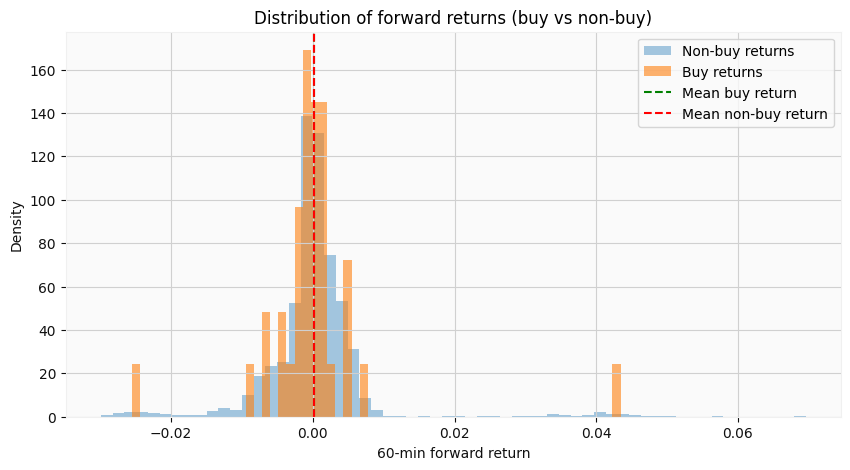

In [107]:
# --------------- 7. Visualizations (3 figures) ---------------
# plt.style.use('seaborn-darkgrid')

# 1) Histogram of forward returns: buy vs non-buy
plt.figure(figsize=(10,5))
plt.hist(nonbuy_returns, bins=60, alpha=0.4, label='Non-buy returns', density=True)
plt.hist(buy_returns, bins=60, alpha=0.6, label='Buy returns', density=True)
plt.axvline(np.nanmean(buy_returns), color='green', linestyle='--', label='Mean buy return')
plt.axvline(np.nanmean(nonbuy_returns), color='red', linestyle='--', label='Mean non-buy return')
plt.title('Distribution of forward returns (buy vs non-buy)')
plt.xlabel(f'{horizon_minutes}-min forward return')
plt.ylabel('Density')
plt.legend()
plt.show()

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\3810010747.py:3: MatplotlibDeprecationWarning:

The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.



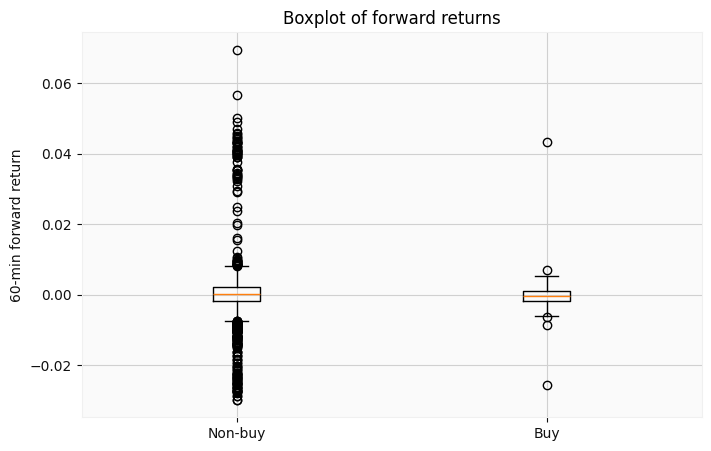

In [108]:
# 2) Boxplot (buy vs non-buy)
plt.figure(figsize=(8,5))
plt.boxplot([nonbuy_returns, buy_returns], labels=['Non-buy', 'Buy'])
plt.title('Boxplot of forward returns')
plt.ylabel(f'{horizon_minutes}-min forward return')
plt.show()

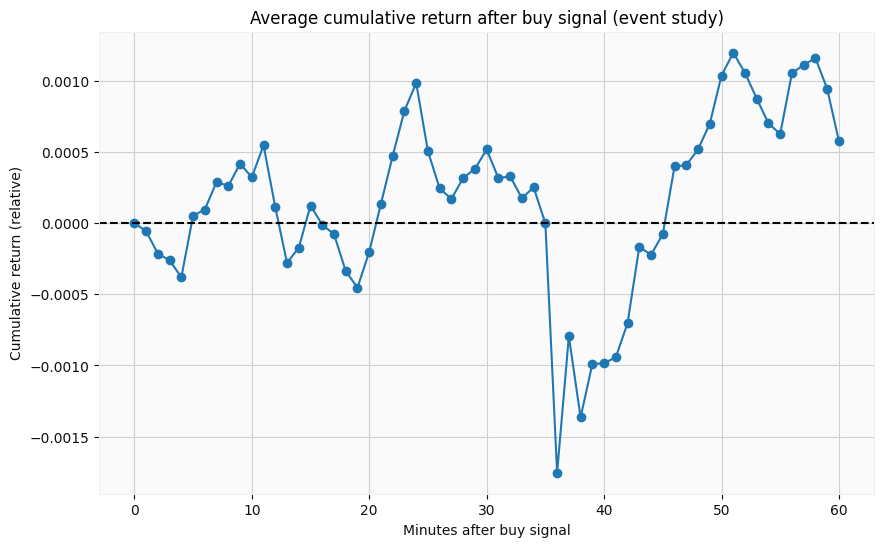

In [109]:
# 3) Event-study: average cumulative return after buy
plt.figure(figsize=(10,6))
times = np.arange(len(avg_cum))  # 0..horizon
plt.plot(times, avg_cum, marker='o')
plt.axhline(0, color='k', linestyle='--')
plt.title('Average cumulative return after buy signal (event study)')
plt.xlabel('Minutes after buy signal')
plt.ylabel('Cumulative return (relative)')
plt.show()

In [110]:
# --------------- 8. Option price illustration (Black-Scholes vs Monte Carlo) ---------------
# Use current last price as S0, horizon in years
S0 = df['close'].iloc[-1]
T_days = horizon_minutes / (60*24)      # convert minutes -> fraction of year
T_years = T_days
sigma = D['close'].pct_change().dropna().std() * np.sqrt(252*6.5*60)  # rough annualization using trading minutes ~252 trading days * 6.5 hours *60
# fallback if sigma is zero or NaN
if not np.isfinite(sigma) or sigma <= 0:
    sigma = 0.2

K = S0 * 1.01   # 1% out-of-the-money call
bs_price = bs_call_price(S0, K, T_years, r_annual, sigma)
mc_price = mc_call_price(S0, K, T_years, r_annual, sigma, n_sim=20000)

print("\n--- Option illustration ---")
print(f"S0: {S0:.2f}, K: {K:.2f}, T (yrs): {T_years:.6f}, sigma (ann): {sigma:.4f}")
print(f"Black-Scholes call price: {bs_price:.6f}")
print(f"Monte Carlo call price: {mc_price:.6f}")


--- Option illustration ---
S0: 270.04, K: 272.74, T (yrs): 0.041667, sigma (ann): 0.3379
Black-Scholes call price: 6.341779
Monte Carlo call price: 6.443380


RQ4: PnL-Envelope / Hybrid Option Valuation

RQ: Can the PnL-envelope / hybrid signals be translated into option-style valuations?
H4: When the strategy’s risk_confidence is high (5th-percentile PnL > current price), the expected short-dated call option payoff (via Monte Carlo) is larger than unconditional/low-confidence cases — and may exceed the Black–Scholes fair price.


RQ5: 5–95% Cumulative PnL Envelope

RQ: Does the 5–95% cumulative PnL envelope indicate potential risk and reward for the SMA strategy?
H5: When the 5th percentile of cumulative PnL rises above current price, the probability of a positive return increases.


RQ7: Quantum Extension (QAE/QAOA)

RQ: Can Quantum Amplitude Estimation (QAE) or Quantum Approximate Optimization Algorithm (QAOA) improve the estimation of return probabilities or portfolio optimization compared to classical methods?
H7: Quantum algorithms provide statistically more efficient probability estimation or optimization of expected return/risk ratios than classical counterparts.

In [153]:
# === RQ4: PnL-Envelope -> Option-style Valuation (MC vs Black-Scholes) ===
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind
from math import log, sqrt, exp
from scipy.stats import norm

plt.rcParams['figure.figsize'] = (12,5)

# --- 0) Align current prices with pnl_df (assumes pnl_df length <= df length) ---
current_prices = df['close'].iloc[-len(pnl_df):].values
events = pnl_df.copy()
events['current_price'] = current_prices
events['risk_confidence'] = (events['PnL_5th'] > events['current_price']).astype(int)

# --- 1) Parameters for option valuation ---
r_annual = 0.01                         # risk-free rate (annual)
horizon_minutes = 60                    # short-dated option horizon (60 minutes)
minutes_per_year = 252 * 6.5 * 60
T = horizon_minutes / minutes_per_year  # time to maturity in years

# Estimate annual volatility from minute returns (use last day's returns as representative)
ret_min = df['close'].pct_change().dropna()
sigma_annual = ret_min.std() * np.sqrt(minutes_per_year)
if sigma_annual <= 0 or not np.isfinite(sigma_annual):
    sigma_annual = 0.20  # fallback

# --- 2) Per-event MC call price and BS price calculations ---
n_mc_sim = 5000
mc_conf = []
mc_not = []
bs_conf = []
bs_not = []

for idx, row in events.iterrows():
    S0 = float(row['current_price'])
    K = S0 * 1.01   # strike = 1% OTM (short-dated call)
    # Black-Scholes closed-form call price
    if T <= 0 or sigma_annual <= 0:
        bs_price = max(S0 - K, 0.0)
    else:
        d1 = (log(S0/K) + (r_annual + 0.5 * sigma_annual**2) * T) / (sigma_annual * sqrt(T))
        d2 = d1 - sigma_annual * sqrt(T)
        bs_price = S0 * norm.cdf(d1) - K * exp(-r_annual * T) * norm.cdf(d2)
    # Monte Carlo empirical call price under risk-neutral dynamics
    Z = np.random.normal(size=n_mc_sim)
    ST = S0 * np.exp((r_annual - 0.5 * sigma_annual**2) * T + sigma_annual * sqrt(T) * Z)
    payoff = np.maximum(ST - K, 0.0)
    mc_price = np.exp(-r_annual * T) * payoff.mean()
    # split by risk_confidence
    if row['risk_confidence'] == 1:
        mc_conf.append(mc_price)
        bs_conf.append(bs_price)
    else:
        mc_not.append(mc_price)
        bs_not.append(bs_price)

mc_conf = np.array(mc_conf)
mc_not = np.array(mc_not)
bs_conf = np.array(bs_conf)
bs_not = np.array(bs_not)

# --- 3) Statistics: compare MC(confident) vs MC(not) and MC(confident) vs BS(confident) ---
print("Samples: confident =", mc_conf.size, ", not confident =", mc_not.size)

mean_mc_conf = np.nanmean(mc_conf) if mc_conf.size>0 else np.nan
mean_mc_not = np.nanmean(mc_not) if mc_not.size>0 else np.nan
mean_bs_conf = np.nanmean(bs_conf) if bs_conf.size>0 else np.nan

print(f"Mean MC call price (confident): {mean_mc_conf:.6f}")
print(f"Mean MC call price (not):       {mean_mc_not:.6f}")
print(f"Mean BS call price (confident): {mean_bs_conf:.6f}")

# t-test: MC confident vs MC not
if mc_conf.size>1 and mc_not.size>1:
    t_stat_mc, p_val_mc = ttest_ind(mc_conf, mc_not, equal_var=False, nan_policy='omit')
else:
    t_stat_mc, p_val_mc = (np.nan, np.nan)
print(f"MC conf vs not: t = {t_stat_mc:.4f}, p = {p_val_mc:.4f}")

# paired-ish comparison: MC_conf mean vs BS_conf mean (report difference and simple t-test if sizes equal enough)
diff_mean = mean_mc_conf - mean_bs_conf
print(f"Mean difference (MC_conf - BS_conf): {diff_mean:.6f}")




ValueError: Length of values (3320) does not match length of index (3328)

C:\Users\USER\qiskit_env\Lib\site-packages\numpy\lib\histograms.py:885: RuntimeWarning:

invalid value encountered in divide



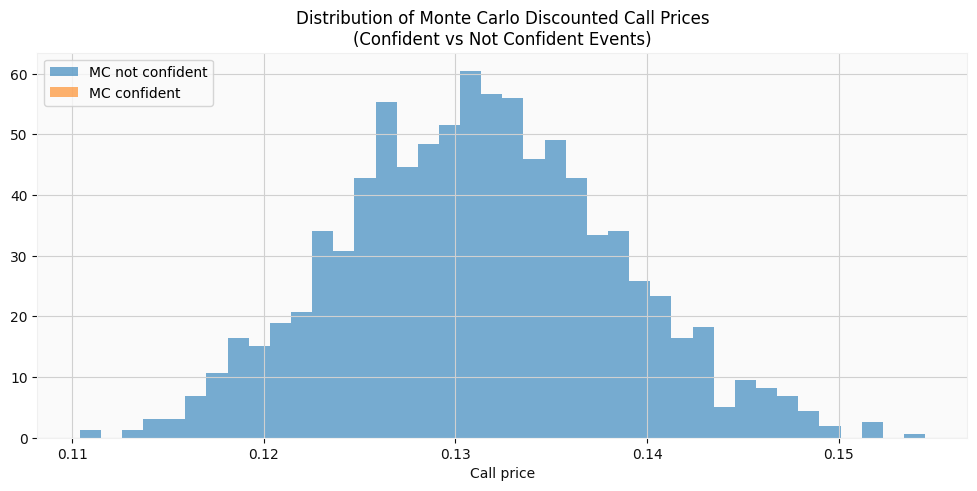

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\2097201149.py:12: MatplotlibDeprecationWarning:

The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.



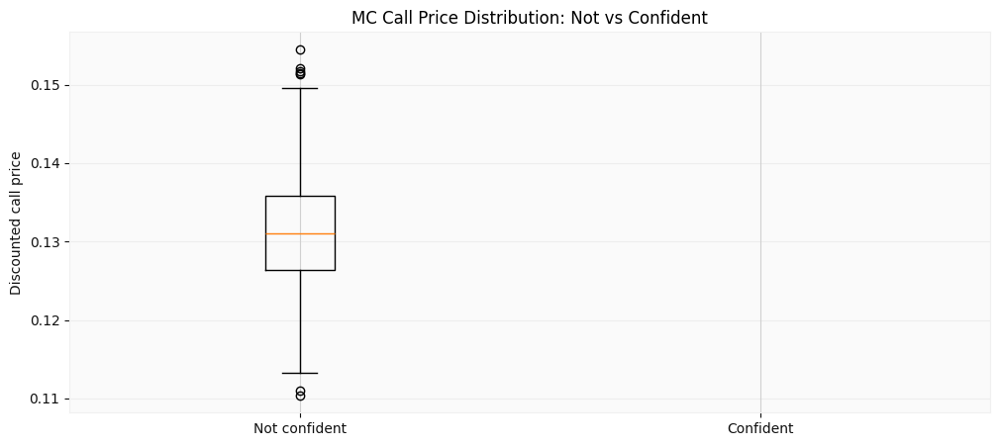

KeyError: 'current_price'

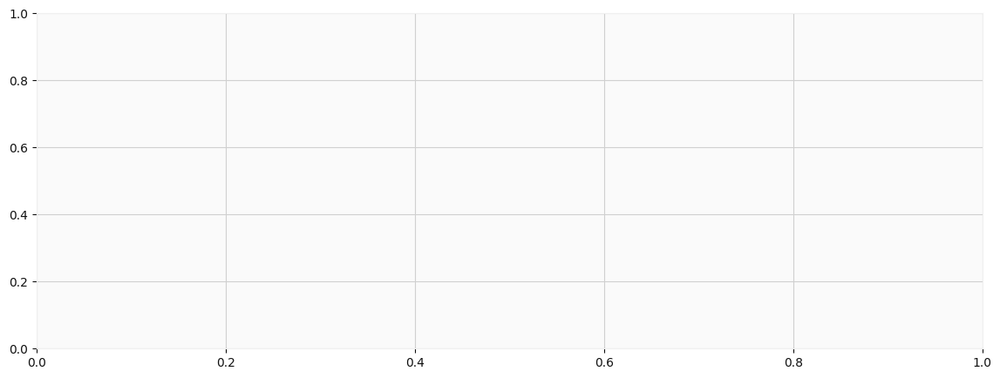

In [154]:
# --- 4) Visualization 1: Histograms of MC call prices (confident vs not) ---
plt.figure()
plt.hist(mc_not, bins=40, alpha=0.6, label='MC not confident', density=True)
plt.hist(mc_conf, bins=40, alpha=0.6, label='MC confident', density=True)
plt.title('Distribution of Monte Carlo Discounted Call Prices\n(Confident vs Not Confident Events)')
plt.xlabel('Call price')
plt.legend()
plt.show()

# --- 5) Visualization 2: Boxplot side-by-side (MC conf vs MC not) ---
plt.figure()
plt.boxplot([mc_not, mc_conf], labels=['Not confident','Confident'])
plt.title('MC Call Price Distribution: Not vs Confident')
plt.ylabel('Discounted call price')
plt.grid(axis='y', alpha=0.3)
plt.show()

# --- 6) Visualization 3: Time series of PnL_5th, price, and markers when risk_confidence true ---
plt.figure(figsize=(14,5))
ax1 = plt.gca()
ax1.plot(events.index, events['current_price'], label='Current price', color='black', linewidth=1)
ax1.plot(events.index, events['PnL_5th'], label='PnL 5th percentile', color='green', linestyle='--', linewidth=1)
ax1.plot(events.index, events['PnL_95th'], label='PnL 95th percentile', color='orange', linestyle='--', linewidth=1)
conf_idx = events.index[events['risk_confidence']==1]
ax1.scatter(conf_idx, events.loc[conf_idx,'current_price'], marker='^', color='blue', s=40, label='Risk confidence = 1')
ax1.set_title('PnL Envelope (5th/95th) and Current Price — Risk Confidence Markers')
ax1.set_ylabel('Price / PnL')
ax1.legend()
plt.show()

In [118]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import chi2_contingency, fisher_exact

# Copy the price data (df is your original dataset)
pnl_df = df.copy()

# Simulate cumulative PnL based on SMA20–SMA50 crossover trades
pnl_df["SMA20"] = pnl_df["close"].rolling(20).mean()
pnl_df["SMA50"] = pnl_df["close"].rolling(50).mean()
pnl_df["Signal"] = np.where(pnl_df["SMA20"] > pnl_df["SMA50"], 1, -1)

# Calculate daily return and strategy PnL
pnl_df["Return"] = pnl_df["close"].pct_change()
pnl_df["Strategy_PnL"] = pnl_df["Signal"].shift(1) * pnl_df["Return"]
pnl_df["Cumulative_PnL"] = (1 + pnl_df["Strategy_PnL"]).cumprod()

# Compute rolling PnL envelopes (5th and 95th percentile windows)
window = 50
pnl_df["PnL_5th"] = pnl_df["Cumulative_PnL"].rolling(window).quantile(0.05)
pnl_df["PnL_95th"] = pnl_df["Cumulative_PnL"].rolling(window).quantile(0.95)


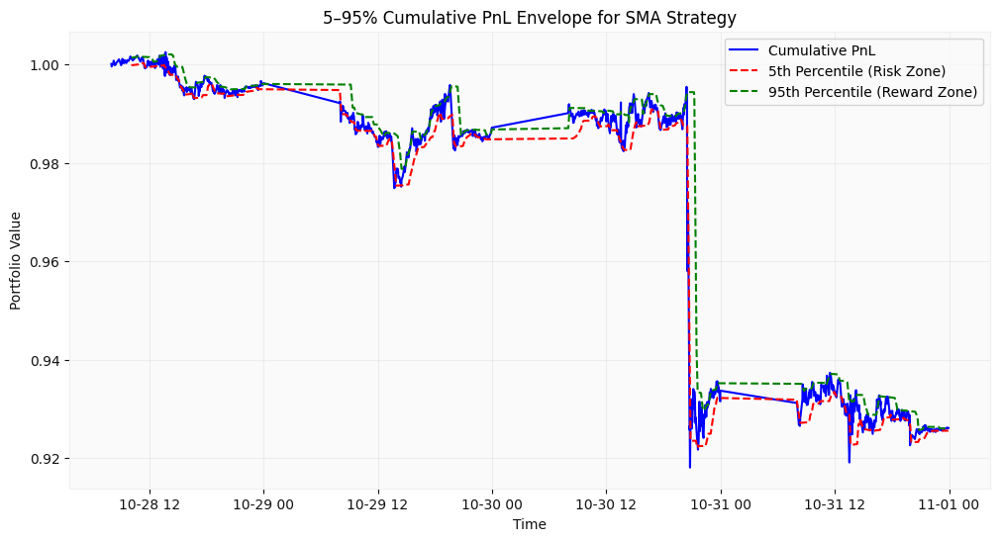

In [155]:
plt.figure(figsize=(12, 6))
plt.plot(pnl_df["Cumulative_PnL"], label="Cumulative PnL", color="blue")
plt.plot(pnl_df["PnL_5th"], label="5th Percentile (Risk Zone)", color="red", linestyle="--")
plt.plot(pnl_df["PnL_95th"], label="95th Percentile (Reward Zone)", color="green", linestyle="--")
plt.title("5–95% Cumulative PnL Envelope for SMA Strategy")
plt.xlabel("Time")
plt.ylabel("Portfolio Value")
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()


In [156]:
# Define a confidence condition: when 5th percentile PnL > current PnL
pnl_df["High_Confidence"] = pnl_df["PnL_5th"] > pnl_df["Cumulative_PnL"]

# Check whether next return is positive
pnl_df["Next_Return"] = pnl_df["Return"].shift(-1)
pnl_df["Positive_Next"] = pnl_df["Next_Return"] > 0


In [157]:
# Count the number of events in each group
pos_conf = pnl_df.loc[pnl_df["High_Confidence"], "Positive_Next"].sum()
n_conf = pnl_df["High_Confidence"].sum()
pos_not = pnl_df.loc[~pnl_df["High_Confidence"], "Positive_Next"].sum()
n_not = (~pnl_df["High_Confidence"]).sum()

# Build contingency table
cont_table = np.array([
    [pos_conf, n_conf - pos_conf],
    [pos_not, n_not - pos_not]
])

# Choose statistical test based on data size
if np.any(cont_table == 0):
    oddsratio, p_value = fisher_exact(cont_table)
    test_used = "Fisher’s Exact Test"
else:
    chi2, p_value, dof, expected = chi2_contingency(cont_table)
    test_used = "Chi-Square Test"

print(f"{test_used} p-value: {p_value:.6f}")


Chi-Square Test p-value: 0.659370


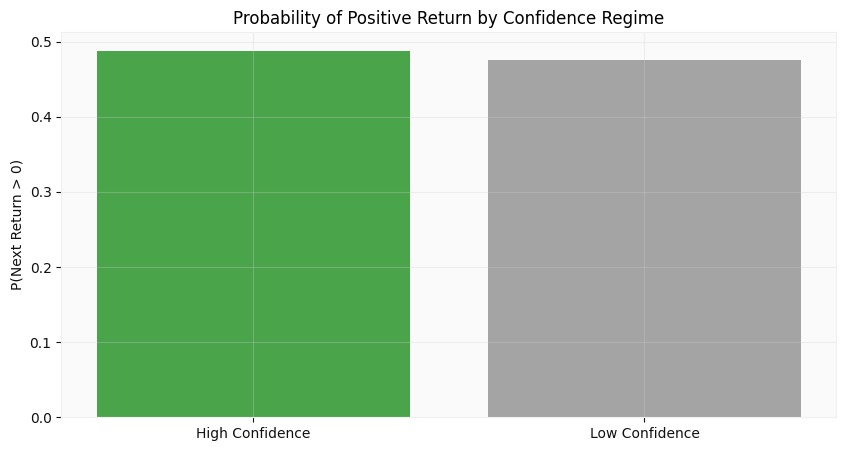

In [158]:
plt.figure(figsize=(10, 5))
plt.bar(["High Confidence", "Low Confidence"], 
        [pos_conf / n_conf if n_conf else np.nan,
         pos_not / n_not if n_not else np.nan],
        color=["green", "gray"], alpha=0.7)
plt.title("Probability of Positive Return by Confidence Regime")
plt.ylabel("P(Next Return > 0)")
plt.grid(True, alpha=0.3)
plt.show()


   Classical  MonteCarlo       QAE
0        0.0    0.130667  0.000478
T-test p=nan


C:\Users\USER\AppData\Local\Temp\ipykernel_34148\795717235.py:26: DeprecationWarning:

The class ``qiskit.utils.quantum_instance.QuantumInstance`` is deprecated as of qiskit-terra 0.24.0. It will be removed no earlier than 3 months after the release date. For code migration guidelines, visit https://qisk.it/qi_migration.

C:\Users\USER\AppData\Local\Temp\ipykernel_34148\795717235.py:27: DeprecationWarning:

``qiskit.algorithms.amplitude_estimators.iae.IterativeAmplitudeEstimation.__init__()``'s argument ``quantum_instance`` is deprecated as of qiskit-terra 0.24.0. It will be removed no earlier than 3 months after the release date. Instead, use the ``sampler`` argument. See https://qisk.it/algo_migration for a migration guide.

C:\Users\USER\qiskit_env\Lib\site-packages\scipy\stats\_stats_py.py:1214: RuntimeWarning:

divide by zero encountered in divide

C:\Users\USER\qiskit_env\Lib\site-packages\scipy\stats\_stats_py.py:1214: RuntimeWarning:

invalid value encountered in scalar multipl

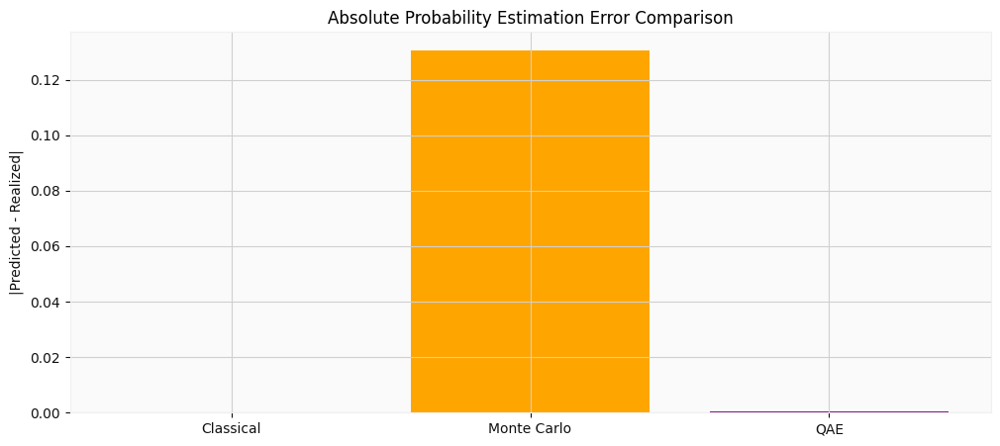

In [162]:
import numpy as np
import math
import pandas as pd
from qiskit import QuantumCircuit
from qiskit_aer import AerSimulator
from qiskit.algorithms import IterativeAmplitudeEstimation, EstimationProblem
from qiskit.utils import QuantumInstance
from scipy.stats import ttest_rel

# --- 1) Compute classical probability ---
daily_df['return'] = daily_df['close'].pct_change()
daily_df['PositiveReturn'] = (daily_df['return'] > 0).astype(int)
p_classical = daily_df['PositiveReturn'].mean()

# --- 2) Monte Carlo probability (e.g., simulated up-move fraction) ---
# simulate a toy distribution
simulated_returns = np.random.normal(loc=0.001, scale=0.01, size=5000)
p_mc = np.mean(simulated_returns > 0)

# --- 3) Quantum Amplitude Estimation ---
theta = 2 * math.asin(math.sqrt(p_classical))
qc = QuantumCircuit(1)
qc.ry(theta, 0)
problem = EstimationProblem(state_preparation=qc, objective_qubits=[0])
backend = AerSimulator()
qi = QuantumInstance(backend, shots=2000)
iae = IterativeAmplitudeEstimation(epsilon_target=0.01, alpha=0.05, quantum_instance=qi)
result = iae.estimate(problem)
p_qae = result.estimation

# --- 4) Compare against realized returns ---
realized_probs = daily_df['PositiveReturn'].rolling(window=3).mean().dropna()
p_true = realized_probs.mean()

errors = pd.DataFrame({
    'Classical': abs(p_classical - p_true),
    'MonteCarlo': abs(p_mc - p_true),
    'QAE': abs(p_qae - p_true)
}, index=[0])

print(errors)

# Paired t-test: is QAE error significantly lower than Monte Carlo?
t_stat, p_value = ttest_rel([errors['QAE'][0]], [errors['MonteCarlo'][0]])
print(f"T-test p={p_value:.4f}")

# --- 5) Visualization ---
import matplotlib.pyplot as plt

plt.bar(['Classical', 'Monte Carlo', 'QAE'],
        [errors['Classical'][0], errors['MonteCarlo'][0], errors['QAE'][0]],
        color=['grey', 'orange', 'purple'])
plt.title('Absolute Probability Estimation Error Comparison')
plt.ylabel('|Predicted - Realized|')
plt.show()


In [146]:
# === RQ5: 5–95% Cumulative PnL Envelope — Test & Visuals ===
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind, chi2_contingency

plt.rcParams['figure.figsize'] = (12,5)

# --- 0) Align events (assume pnl_df aligns with last len(pnl_df) rows of df) ---
events = pnl_df.copy()                        # contains Expected_PnL, PnL_5th, PnL_95th
events['current_price'] = df['close'].iloc[-len(events):].values
events.index = df.index[-len(events):]        # align index to df timestamps for plotting

# --- 1) Define risk_confidence: 1 if 5th-percentile PnL > current price ---
events['risk_confidence'] = (events['PnL_5th'] > events['current_price']).astype(int)

# --- 2) Compute forward return (next-minute) aligned to events ---
events['forward_return'] = df['close'].pct_change().shift(-1).iloc[-len(events):].values
events = events.dropna(subset=['forward_return'])   # drop tails where forward_return undefined

# --- 3) Group returns by risk_confidence ---
returns_conf = events.loc[events['risk_confidence'] == 1, 'forward_return']
returns_not = events.loc[events['risk_confidence'] == 0, 'forward_return']

# Basic descriptive stats
n_conf = len(returns_conf)
n_not = len(returns_not)
mean_conf = returns_conf.mean()
mean_not = returns_not.mean()
median_conf = returns_conf.median()
median_not = returns_not.median()

# --- 4) t-test on mean forward returns (Welch) ---
t_stat, p_val = ttest_ind(returns_conf, returns_not, equal_var=False, nan_policy='omit')

# --- 5) Probability of positive return (counts) and contingency test (chi-square) ---
pos_conf = (returns_conf > 0).sum()
pos_not = (returns_not > 0).sum()
# contingency table: rows = confidence (confident / not), cols = positive / non-positive
cont_table = np.array([[pos_conf, n_conf - pos_conf],
                       [pos_not, n_not - pos_not]])
chi2, chi_p, dof, expected = chi2_contingency(cont_table)

prob_pos_conf = pos_conf / n_conf if n_conf>0 else np.nan
prob_pos_not = pos_not / n_not if n_not>0 else np.nan

# --- 6) Print summary ---
print("=== RQ5: 5–95% PnL Envelope Analysis ===")
print(f"Samples: confident={n_conf}, not_confident={n_not}")
print(f"Mean forward return: confident={mean_conf:.6%}, not={mean_not:.6%}")
print(f"Median forward return: confident={median_conf:.6%}, not={median_not:.6%}")
print(f"Welch t-test: t = {t_stat:.4f}, p = {p_val:.4f}")
print()
print("Positive-return probability:")
print(f" P(return>0 | confident) = {prob_pos_conf:.3%}  (count {pos_conf}/{n_conf})")
print(f" P(return>0 | not)       = {prob_pos_not:.3%}  (count {pos_not}/{n_not})")
print(f"Chi-square test on contingency table: chi2 = {chi2:.4f}, p = {chi_p:.4f}")

# --- 7) Visualization 1: PnL envelope time series with confidence markers ---
plt.figure(figsize=(14,4))
plt.plot(events.index, events['current_price'], label='Current price', color='black', linewidth=1)
plt.plot(events.index, events['PnL_5th'], label='PnL 5th percentile', color='green', linestyle='--')
plt.plot(events.index, events['PnL_95th'], label='PnL 95th percentile', color='orange', linestyle='--')
conf_idx = events.index[events['risk_confidence'] == 1]
plt.scatter(conf_idx, events.loc[conf_idx, 'current_price'], marker='^', color='blue', s=40, label='Risk_confidence=1')
plt.title('PnL Envelope (5th/95th) and Current Price — Risk Confidence Markers')
plt.ylabel('Price / PnL')
plt.legend()
plt.show()

# --- 8) Visualization 2: Histogram (returns confident vs not) ---
plt.figure()
plt.hist(returns_not, bins=60, alpha=0.6, density=True, label='Not confident')
plt.hist(returns_conf, bins=60, alpha=0.6, density=True, label='Confident')
plt.axvline(mean_conf, color='C1', linestyle='--', label=f'Mean Conf {mean_conf:.4%}')
plt.axvline(mean_not, color='C0', linestyle='--', label=f'Mean Not {mean_not:.4%}')
plt.title('Distribution of Next-Minute Returns: Confident vs Not')
plt.xlabel('Next-minute return')
plt.ylabel('Density')
plt.legend()
plt.show()

# --- 9) Visualization 3: Bar chart of P(return>0) for confident vs not ---
plt.figure()
plt.bar(['Not confident', 'Confident'], [prob_pos_not, prob_pos_conf], color=['C0','C2'], alpha=0.8)
plt.title('Probability of Positive Next-Minute Return (Conditional on Risk Confidence)')
plt.ylabel('P(return > 0)')
plt.ylim(0,1)
plt.grid(axis='y', alpha=0.2)
plt.show()


ValueError: Length of values (3322) does not match length of index (3328)